In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!pip install einops

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 43.2/43.2 kB 2.7 MB/s eta 0:00:00


In [1]:
modelname='model02'

name_dir= "/content/drive/MyDrive/ambidata"
SEED = 9876#####1234####10000
SAMPLES=3

#Stage2

In [2]:
%cd "/content/drive/MyDrive/ambidata"


/content/drive/MyDrive/ambidata


In [3]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import torch.optim.lr_scheduler as lr_scheduler
from torch.optim.lr_scheduler import _LRScheduler
import torch.utils.data as data

import torchvision.transforms as transforms
import torchvision.datasets as datasets
import torchvision.models as models

from sklearn import decomposition
from sklearn import manifold
from sklearn.metrics import confusion_matrix
from sklearn.metrics import ConfusionMatrixDisplay
import matplotlib.pyplot as plt
import numpy as np

import copy
from collections import namedtuple
import os
import random
import shutil
import time

In [4]:
train_dir= name_dir+'/featureexploredataset/train'
test_dir=name_dir+'/featureexploredataset/testtrain'

In [5]:

pretrained_size = 224
pretrained_means = [0.485, 0.456, 0.406]
pretrained_stds= [0.229, 0.224, 0.225]

train_transforms = transforms.Compose([
                          #  transforms.Resize(pretrained_size),
                           transforms.Resize((pretrained_size, pretrained_size)),
                           transforms.RandomRotation(5),
                           transforms.RandomHorizontalFlip(0.5),
                          #  transforms.RandomCrop(pretrained_size, padding = 10),
                           transforms.ToTensor(),
                           transforms.Normalize(mean = pretrained_means,
                                                std = pretrained_stds)
                       ])

test_transforms = transforms.Compose([
                           transforms.Resize(pretrained_size),
                           transforms.CenterCrop(pretrained_size),
                           transforms.ToTensor(),
                           transforms.Normalize(mean = pretrained_means,
                                                std = pretrained_stds)
                       ])

In [6]:
train_data = datasets.ImageFolder(root = train_dir,
                                  transform = train_transforms)

test_data = datasets.ImageFolder(root = test_dir,
                                 transform = test_transforms)
classes = train_data.classes
classes

['nega', 'posi']

In [7]:
VALID_RATIO = 0.9

n_train_examples = int(len(train_data) * VALID_RATIO)
n_valid_examples = len(train_data) - n_train_examples

train_data, valid_data = data.random_split(train_data,
                                           [n_train_examples, n_valid_examples])

In [8]:
valid_data = copy.deepcopy(valid_data)
valid_data.dataset.transform = test_transforms

In [9]:
print(f'Number of training examples: {len(train_data)}')
print(f'Number of validation examples: {len(valid_data)}')
print(f'Number of testing examples: {len(test_data)}')

Number of training examples: 225
Number of validation examples: 25
Number of testing examples: 66


In [10]:
BATCH_SIZE = 16

train_iterator = data.DataLoader(train_data,
                                 shuffle = True,
                                 batch_size = BATCH_SIZE)

valid_iterator = data.DataLoader(valid_data,
                                 batch_size = BATCH_SIZE)

test_iterator = data.DataLoader(test_data,
                                batch_size = BATCH_SIZE)

In [11]:
def normalize_image(image):
    image_min = image.min()
    image_max = image.max()
    image.clamp_(min = image_min, max = image_max)
    image.add_(-image_min).div_(image_max - image_min + 1e-5)
    return image

In [12]:
def plot_images(images, labels, classes, normalize = True):

    n_images = len(images)

    rows = int(np.sqrt(n_images))
    cols = int(np.sqrt(n_images))

    fig = plt.figure(figsize = (15, 15))

    for i in range(rows*cols):

        ax = fig.add_subplot(rows, cols, i+1)

        image = images[i]

        if normalize:
            image = normalize_image(image)

        ax.imshow(image.permute(1, 2, 0).cpu().numpy())
        label = classes[labels[i]]
        ax.set_title(label)
        ax.axis('off')

In [13]:
len(train_data)

225

In [14]:
class ResNet(nn.Module):
    def __init__(self, config, output_dim):
        super().__init__()

        block, n_blocks, channels = config
        self.in_channels = channels[0]

        assert len(n_blocks) == len(channels) == 4

        self.conv1 = nn.Conv2d(3, self.in_channels, kernel_size = 7, stride = 2, padding = 3, bias = False)
        self.bn1 = nn.BatchNorm2d(self.in_channels)
        self.relu = nn.ReLU(inplace = True)
        self.maxpool = nn.MaxPool2d(kernel_size = 3, stride = 2, padding = 1)

        self.layer1 = self.get_resnet_layer(block, n_blocks[0], channels[0])
        self.layer2 = self.get_resnet_layer(block, n_blocks[1], channels[1], stride = 2)
        self.layer3 = self.get_resnet_layer(block, n_blocks[2], channels[2], stride = 2)
        self.layer4 = self.get_resnet_layer(block, n_blocks[3], channels[3], stride = 2)

        self.avgpool = nn.AdaptiveAvgPool2d((1,1))
        self.fc = nn.Linear(self.in_channels, output_dim)

    def get_resnet_layer(self, block, n_blocks, channels, stride = 1):

        layers = []

        if self.in_channels != block.expansion * channels:
            downsample = True
        else:
            downsample = False

        layers.append(block(self.in_channels, channels, stride, downsample))

        for i in range(1, n_blocks):
            layers.append(block(block.expansion * channels, channels))

        self.in_channels = block.expansion * channels

        return nn.Sequential(*layers)

    def forward(self, x):

        x = self.conv1(x)
        x = self.bn1(x)
        x = self.relu(x)
        x = self.maxpool(x)

        x = self.layer1(x)
        x = self.layer2(x)
        x = self.layer3(x)
        x = self.layer4(x)

        x = self.avgpool(x)
        h = x.view(x.shape[0], -1)
        h=F.normalize(h, dim=-1)#######
        x = self.fc(h)

        return x, h

In [15]:
ResNetConfig = namedtuple('ResNetConfig', ['block', 'n_blocks', 'channels'])

In [16]:
class Bottleneck(nn.Module):

    expansion = 4

    def __init__(self, in_channels, out_channels, stride = 1, downsample = False):
        super().__init__()

        self.conv1 = nn.Conv2d(in_channels, out_channels, kernel_size = 1,
                               stride = 1, bias = False)
        self.bn1 = nn.BatchNorm2d(out_channels)

        self.conv2 = nn.Conv2d(out_channels, out_channels, kernel_size = 3,
                               stride = stride, padding = 1, bias = False)
        self.bn2 = nn.BatchNorm2d(out_channels)

        self.conv3 = nn.Conv2d(out_channels, self.expansion * out_channels, kernel_size = 1,
                               stride = 1, bias = False)
        self.bn3 = nn.BatchNorm2d(self.expansion * out_channels)

        self.relu = nn.ReLU(inplace = True)

        if downsample:
            conv = nn.Conv2d(in_channels, self.expansion * out_channels, kernel_size = 1,
                             stride = stride, bias = False)
            bn = nn.BatchNorm2d(self.expansion * out_channels)
            downsample = nn.Sequential(conv, bn)
        else:
            downsample = None

        self.downsample = downsample

    def forward(self, x):

        i = x

        x = self.conv1(x)
        x = self.bn1(x)
        x = self.relu(x)

        x = self.conv2(x)
        x = self.bn2(x)
        x = self.relu(x)

        x = self.conv3(x)
        x = self.bn3(x)

        if self.downsample is not None:
            i = self.downsample(i)

        x += i
        x = self.relu(x)

        return x

In [17]:
resnet50_config = ResNetConfig(block = Bottleneck,
                               n_blocks = [3, 4, 6, 3],
                               channels = [64, 128, 256, 512])


In [18]:
pretrained_model = models.resnet50(pretrained = True)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


In [19]:
IN_FEATURES = pretrained_model.fc.in_features
OUTPUT_DIM = len(test_data.classes)

# fc = nn.Linear(IN_FEATURES, OUTPUT_DIM)
fc = nn.Linear(IN_FEATURES, OUTPUT_DIM*SAMPLES)###########################divdis2

In [20]:
pretrained_model.fc = fc

In [21]:
model = ResNet(resnet50_config, OUTPUT_DIM*SAMPLES)###########################divdis2

In [22]:
model.load_state_dict(pretrained_model.state_dict())

<All keys matched successfully>

In [23]:
def count_parameters(model):
    return sum(p.numel() for p in model.parameters() if p.requires_grad)

print(f'The model has {count_parameters(model):,} trainable parameters')

The model has 23,520,326 trainable parameters


In [24]:
# START_LR = 1e-8##1e-7

# # optimizer = optim.Adam(model.parameters(), lr=START_LR)

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

criterion = nn.CrossEntropyLoss()

model = model.to(device)
criterion = criterion.to(device)

In [25]:

torch.save(model.state_dict(), "init_modeldivdis2.pt")

In [26]:
print([n for n, _ in model.named_children()])

['conv1', 'bn1', 'relu', 'maxpool', 'layer1', 'layer2', 'layer3', 'layer4', 'avgpool', 'fc']


In [27]:
param_optimizer = list(model.named_parameters())#test grad
[n for n, p in param_optimizer ]

['conv1.weight',
 'bn1.weight',
 'bn1.bias',
 'layer1.0.conv1.weight',
 'layer1.0.bn1.weight',
 'layer1.0.bn1.bias',
 'layer1.0.conv2.weight',
 'layer1.0.bn2.weight',
 'layer1.0.bn2.bias',
 'layer1.0.conv3.weight',
 'layer1.0.bn3.weight',
 'layer1.0.bn3.bias',
 'layer1.0.downsample.0.weight',
 'layer1.0.downsample.1.weight',
 'layer1.0.downsample.1.bias',
 'layer1.1.conv1.weight',
 'layer1.1.bn1.weight',
 'layer1.1.bn1.bias',
 'layer1.1.conv2.weight',
 'layer1.1.bn2.weight',
 'layer1.1.bn2.bias',
 'layer1.1.conv3.weight',
 'layer1.1.bn3.weight',
 'layer1.1.bn3.bias',
 'layer1.2.conv1.weight',
 'layer1.2.bn1.weight',
 'layer1.2.bn1.bias',
 'layer1.2.conv2.weight',
 'layer1.2.bn2.weight',
 'layer1.2.bn2.bias',
 'layer1.2.conv3.weight',
 'layer1.2.bn3.weight',
 'layer1.2.bn3.bias',
 'layer2.0.conv1.weight',
 'layer2.0.bn1.weight',
 'layer2.0.bn1.bias',
 'layer2.0.conv2.weight',
 'layer2.0.bn2.weight',
 'layer2.0.bn2.bias',
 'layer2.0.conv3.weight',
 'layer2.0.bn3.weight',
 'layer2.0.bn3.b

In [28]:
FOUND_LR = 1e-4

params = [
          {'params': model.conv1.parameters(), 'lr': FOUND_LR / 10},
          {'params': model.bn1.parameters(), 'lr': FOUND_LR / 10},
          {'params': model.layer1.parameters(), 'lr': FOUND_LR / 8},
          {'params': model.layer2.parameters(), 'lr': FOUND_LR / 6},
          {'params': model.layer3.parameters(), 'lr': FOUND_LR / 4},
          {'params': model.layer4.parameters(), 'lr': FOUND_LR / 2},
          {'params': model.fc.parameters()}
         ]


optimizer = optim.Adam(params, lr = FOUND_LR)


In [29]:
EPOCHS = 50
STEPS_PER_EPOCH = len(train_iterator)
TOTAL_STEPS = EPOCHS * STEPS_PER_EPOCH

MAX_LRS = [p['lr'] for p in optimizer.param_groups]

scheduler = lr_scheduler.OneCycleLR(optimizer,
                                    max_lr = MAX_LRS,
                                    total_steps = TOTAL_STEPS)

In [30]:
# # def othologyloss(matrix):###################################BtB-I
# #   matrix=matrix.view(matrix.shape[0]*matrix.shape[1],-1)
# #   matrix2=torch.transpose(matrix,0,1)
# #   return max(torch.norm(torch.matmul(matrix2,matrix), dim=1))


# def othologyloss(matrix):###################################BtB-I
#   # # matrix=matrix.view(matrix.shape[0]*matrix.shape[1],matrix.shape[2],-1)
#   # # matrix2=torch.transpose(matrix,1,2)
#   # # return torch.mean(torch.abs(torch.matmul(matrix,matrix2)-torch.eye(matrix.shape[1]).to(device)))####, dim=1))
#   # matrix=torch.transpose(matrix,0,1)
#   # # print(matrix.shape)
#   # matrix=matrix.contiguous().view(matrix.shape[0],matrix.shape[1]*matrix.shape[2],-1)##https://stackoverflow.com/questions/66750391/runtimeerror-view-size-is-not-compatible-with-input-tensors-size-and-stride-a
#   # matrix2=torch.transpose(matrix,1,2)
#   # return torch.mean(torch.linalg.matrix_norm(torch.matmul(matrix,matrix2)-torch.eye(matrix.shape[1]).to(device), ord=2))#, dim=(- 2, - 1), keepdim=False, *, dtype=None, out=None)


#   matrix=F.normalize(matrix, dim=2)
#   matrix=torch.transpose(matrix,0,1)
#   # print(matrix.shape)
#   matrix2=torch.transpose(matrix,1,2)
#   # print(matrix2.shape)
#   matmulmatrix=torch.bmm(matrix,matrix2 )
#   # print(matmulmatrix.shape)
#   # print (matmulmatrix-torch.eye(matrix.shape[1]).to(device))
#   matrix_norm=torch.linalg.matrix_norm(matmulmatrix.mean(dim=0)-torch.eye(matrix.shape[1]).to(device), ord=1)
#   return torch.mean(matrix_norm)





### DivDIS Stage2

In [31]:
from torch.utils.data import ConcatDataset, DataLoader, Subset
from tqdm.auto import tqdm
# unlabeled_set = DatasetFolder("food-11/training/unlabeled", loader=lambda x: Image.open(x), extensions="jpg", transform=test_transforms)
# test_set = DatasetFolder("food-11/testing", loader=lambda x: Image.open(x), extensions="jpg", transform=test_tfm)
testa_dir=name_dir+'/featureexploredataset/test/k_doi_mu'
BATCH_SIZEa=8
testmu_data = datasets.ImageFolder(root = testa_dir,
                                 transform = test_transforms)
testa_dir=name_dir+'/featureexploredataset/test/k_tre'
testtre_data = datasets.ImageFolder(root = testa_dir,
                                 transform = test_transforms)
testa_dir=name_dir+'/featureexploredataset/test/kcuoi'
testcuoi_data = datasets.ImageFolder(root = testa_dir,
                                 transform = test_transforms)
testambi_datas=[testmu_data, testtre_data, testcuoi_data]


In [32]:
def get_pseudo_labels(dataset, model):
    batch_size=BATCH_SIZEa###################################thêm
    loader = DataLoader(dataset, batch_size=batch_size*3, shuffle=False, pin_memory=True)
    pseudo_labels = []
    for batch in tqdm(loader):
        # A batch consists of image data and corresponding labels.
        img, _ = batch

        # Forward the data
        # Using torch.no_grad() accelerates the forward process.
        with torch.no_grad():
            logits,_ = model(img.to(device))
            # (logits, _), log_priors  = model(img.to(device))######################################svgd
            # logits=logits.mean(dim=0)######################################svgd
            pseudo_labels.append(logits.argmax(dim=-1).detach().cpu())
        # Obtain the probability distributions by applying softmax on logits.
    pseudo_labels = torch.cat(pseudo_labels)
    # Update the labels by replacing with pseudo labels.
    for idx, ((img, _), pseudo_label) in enumerate(zip(dataset.samples, pseudo_labels)):
        dataset.samples[idx] = (img, pseudo_label.item())
    return dataset

In [33]:
testa_data=[]
for td in testambi_datas:
    testa_data.append(get_pseudo_labels(td, model))
testa_data=ConcatDataset(testa_data)
# testa_iterator = data.DataLoader(testa_data,
#                                 batch_size = BATCH_SIZEa)

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

In [34]:
VALID_RATIO = 0.9
BATCH_SIZEa=8

n_train_examples = int(len(testa_data) * VALID_RATIO)
n_valid_examples = len(testa_data) - n_train_examples

testa_data, valida_data = data.random_split(testa_data,
                                           [n_train_examples, n_valid_examples])
testa_iterator = data.DataLoader(testa_data,
                                batch_size = BATCH_SIZEa)
valida_iterator = data.DataLoader(valida_data,
                                batch_size = BATCH_SIZEa)

###ambiguity test div BTB

In [35]:
from divdisorigin import DivDisLoss
loss_fn = DivDisLoss(heads=SAMPLES)#(heads=num_particles)#(heads=num_particles+1)
# loss_fntrain = DivDisLoss(heads=num_particles)#(heads=num_particles)#(heads=num_particles+1)
from itertools import cycle ############################divdis2
from torch.distributions.categorical import Categorical
argsreg_mode="entropy"
def train(model, iterator,ambi_iterator, optimizer, criterion, scheduler, device):#####################thêm ambi_iterator

    epoch_loss = 0
    epoch_acc_1 = 0
    epoch_acc_5 = 0

    model.train()
    loader_both = zip(iterator, cycle(ambi_iterator))#########################divdis2
    for batch_idx, (batch, batch_unlabeled) in enumerate(loader_both):
        x,y=batch
        x_unlabeled, *_ = batch_unlabeled
        x_unlabeled = x_unlabeled.to(device)

        x = x.to(device)
        y = y.to(device)

        optimizer.zero_grad()

        yhat, _ = model(x)######################## _ là feature h
        yhat_unlabeled,_1 = model(x_unlabeled)

        all_loss_mains = []
        yhat_chunked = torch.chunk(yhat, SAMPLES, dim=-1)
        for i, _yhat in enumerate(yhat_chunked):
            loss_main = criterion(_yhat.softmax(dim=-1), y)
            all_loss_mains.append(loss_main)

        loss_main = torch.stack(all_loss_mains).mean()

        repulsion_loss = loss_fn(yhat_unlabeled)
        loss_main += repulsion_loss * 10.0

        yhat_unlabeled_chunked = torch.chunk(yhat_unlabeled, SAMPLES, dim=-1)
        preds = torch.stack(yhat_unlabeled_chunked).softmax(-1)

        if argsreg_mode == "entropy":
            avg_preds = preds.mean(1)
            entropies = -Categorical(probs=avg_preds).entropy()
            reg_loss = entropies.mean()

        loss_main += reg_loss * 10.0


        print(torch.stack(yhat_chunked).shape)
        acc_1, acc_5 = calculate_topk_accuracy(torch.stack(yhat_chunked).softmax(-1).mean(0), y)

        loss_main.backward()

        optimizer.step()

        scheduler.step()

        epoch_loss += loss_main.item()
        epoch_acc_1 += acc_1.item()
        epoch_acc_5 += acc_5.item()



    epoch_loss /= len(iterator)
    epoch_acc_1 /= len(iterator)
    epoch_acc_5 /= len(iterator)

    return epoch_loss, epoch_acc_1, epoch_acc_5

In [36]:
def calculate_topk_accuracy(y_pred, y, k = 2):
    with torch.no_grad():
        batch_size = y.shape[0]
        _, top_pred = y_pred.topk(k, 1)
        top_pred = top_pred.t()
        correct = top_pred.eq(y.view(1, -1).expand_as(top_pred))
        # print(correct[:1])
        correct_1 = correct[:1].reshape(-1).float().sum(0, keepdim = True)
        correct_k = correct[:k].reshape(-1).float().sum(0, keepdim = True)
        acc_1 = correct_1 / batch_size
        acc_k = correct_k / batch_size
    return acc_1, correct[0:1].float().mean()

In [37]:
def evaluate(model, iterator,ambi_iterator, criterion, device):

    epoch_loss = 0
    epoch_acc_1 = 0
    epoch_acc_5 = 0

    model.eval()

    with torch.no_grad():

      loader_both = zip(iterator, cycle(ambi_iterator))#########################divdis2
      for batch_idx, (batch, batch_unlabeled) in enumerate(loader_both):
          x,y=batch
          x_unlabeled, *_ = batch_unlabeled
          x_unlabeled = x_unlabeled.to(device)

          x = x.to(device)
          y = y.to(device)

          optimizer.zero_grad()

          yhat, _ = model(x)######################## _ là feature h
          yhat_unlabeled, _1 = model(x_unlabeled)

          all_loss_mains = []
          yhat_chunked = torch.chunk(yhat, SAMPLES, dim=-1)
          for i, _yhat in enumerate(yhat_chunked):
              loss_main = criterion(_yhat.softmax(dim=-1), y)
              all_loss_mains.append(loss_main)

          loss_main = torch.stack(all_loss_mains).mean()

          repulsion_loss = loss_fn(yhat_unlabeled)
          loss_main += repulsion_loss * 10.0

          yhat_unlabeled_chunked = torch.chunk(yhat_unlabeled, SAMPLES, dim=-1)
          preds = torch.stack(yhat_unlabeled_chunked).softmax(-1)

          if argsreg_mode == "entropy":
              avg_preds = preds.mean(1)
              entropies = -Categorical(probs=avg_preds).entropy()
              reg_loss = entropies.mean()

          loss_main += reg_loss * 10.0



          acc_1, acc_5 = calculate_topk_accuracy(torch.stack(yhat_chunked).softmax(-1).mean(0), y)



          epoch_loss += loss_main.item()
          epoch_acc_1 += acc_1.item()
          epoch_acc_5 += acc_5.item()


    epoch_loss /= len(iterator)
    epoch_acc_1 /= len(iterator)
    epoch_acc_5 /= len(iterator)

    return epoch_loss, epoch_acc_1, epoch_acc_5

In [38]:
def epoch_time(start_time, end_time):
    elapsed_time = end_time - start_time
    elapsed_mins = int(elapsed_time / 60)
    elapsed_secs = int(elapsed_time - (elapsed_mins * 60))
    return elapsed_mins, elapsed_secs

In [39]:
best_valid_loss = float('inf')

for epoch in range(EPOCHS):

    start_time = time.monotonic()

    train_loss, train_acc_1, train_acc_5 = train(model, train_iterator,testa_iterator, optimizer, criterion, scheduler, device)##########thêm ambi_iterator
    valid_loss, valid_acc_1, valid_acc_5 = evaluate(model, valid_iterator,valida_iterator, criterion, device)

    if valid_loss < best_valid_loss:
        best_valid_loss = valid_loss
        torch.save(model.state_dict(), 'tut5-model.pt')

    end_time = time.monotonic()

    epoch_mins, epoch_secs = epoch_time(start_time, end_time)

    print(f'Epoch: {epoch+1:02} | Epoch Time: {epoch_mins}m {epoch_secs}s')
    print(f'\tTrain Loss: {train_loss:.3f} | Train Acc @1: {train_acc_1*100:6.2f}% | ' \
          f'Train Acc @5: {train_acc_5*100:6.2f}%')
    print(f'\tValid Loss: {valid_loss:.3f} | Valid Acc @1: {valid_acc_1*100:6.2f}% | ' \
          f'Valid Acc @5: {valid_acc_5*100:6.2f}%')

torch.Size([3, 16, 2])
torch.Size([3, 16, 2])
torch.Size([3, 16, 2])
torch.Size([3, 16, 2])
torch.Size([3, 16, 2])
torch.Size([3, 16, 2])
torch.Size([3, 16, 2])
torch.Size([3, 16, 2])
torch.Size([3, 16, 2])
torch.Size([3, 16, 2])
torch.Size([3, 16, 2])
torch.Size([3, 16, 2])
torch.Size([3, 16, 2])
torch.Size([3, 16, 2])
torch.Size([3, 1, 2])
Epoch: 01 | Epoch Time: 0m 11s
	Train Loss: -6.239 | Train Acc @1:  54.58% | Train Acc @5:  54.58%
	Valid Loss: -6.238 | Valid Acc @1:  52.08% | Valid Acc @5:  52.08%
torch.Size([3, 16, 2])
torch.Size([3, 16, 2])
torch.Size([3, 16, 2])
torch.Size([3, 16, 2])
torch.Size([3, 16, 2])
torch.Size([3, 16, 2])
torch.Size([3, 16, 2])
torch.Size([3, 16, 2])
torch.Size([3, 16, 2])
torch.Size([3, 16, 2])
torch.Size([3, 16, 2])
torch.Size([3, 16, 2])
torch.Size([3, 16, 2])
torch.Size([3, 16, 2])
torch.Size([3, 1, 2])
Epoch: 02 | Epoch Time: 0m 14s
	Train Loss: -6.239 | Train Acc @1:  72.50% | Train Acc @5:  72.50%
	Valid Loss: -6.239 | Valid Acc @1:  67.01% | 

In [40]:
torch.save(model.state_dict(), 'tut5-'+modelname+'-stage2.pt')

In [41]:
model.load_state_dict(torch.load('tut5-model.pt'))

test_loss, test_acc_1, test_acc_5 = evaluate(model, test_iterator, valida_iterator, criterion, device)

print(f'Test Loss: {test_loss:.3f} | Test Acc @1: {test_acc_1*100:6.2f}% | ' \
      f'Test Acc @5: {test_acc_5*100:6.2f}%')

Test Loss: -6.365 | Test Acc @1:  98.75% | Test Acc @5:  98.75%


#### k doi mu

In [42]:
testa_dir=name_dir+'/featureexploredataset/test/k_doi_mu'
BATCH_SIZEa=1
testa_data = datasets.ImageFolder(root = testa_dir,
                                 transform = test_transforms)
testa_iterator = data.DataLoader(testa_data,
                                batch_size = BATCH_SIZEa)

In [43]:
def get_predictions(model, iterator):

    model.eval()

    images = []
    labels = []
    probs = []

    with torch.no_grad():

        for (x, y) in iterator:

            x = x.to(device)

            yhat, _ = model(x)

            y_pred_ensemble= torch.stack(torch.chunk(yhat, SAMPLES, dim=-1)).softmax(dim=-1)
            y_pred=y_pred_ensemble.mean(dim=0)######################################svgd
            # y_pred=(y_pred_ensemble[2]+y_pred_ensemble[2])/2.0######################################svgd


            y_prob = F.softmax(y_pred, dim = -1)
            top_pred = y_prob.argmax(1, keepdim = True)

            images.append(x.cpu())
            labels.append(y.cpu())
            probs.append(y_prob.cpu())

    images = torch.cat(images, dim = 0)
    labels = torch.cat(labels, dim = 0)
    probs = torch.cat(probs, dim = 0)

    return images, labels, probs

In [44]:
images, labels, probs = get_predictions(model, testa_iterator)
pred_labels = torch.argmax(probs, 1)

In [45]:
corrects = torch.eq(labels, pred_labels)
corrects

tensor([ True,  True, False,  True, False,  True, False, False, False,  True,
        False, False,  True,  True, False, False, False, False,  True,  True,
        False,  True,  True,  True, False,  True,  True])

In [46]:
len(corrects)- torch.sum(corrects)

tensor(13)

In [47]:
corrects.float().mean()

tensor(0.5185)

In [48]:
incorrect_examples = []

for image, label, prob, correct in zip(images, labels, probs, corrects):
    if not correct:########## cmt nếu muốn show all
        incorrect_examples.append((image, label, prob))

incorrect_examples.sort(reverse = True, key = lambda x: torch.max(x[2], dim = 0).values)

In [49]:
incorrect_examples

[(tensor([[[-2.0494, -2.0323, -2.0152,  ..., -0.3369, -0.5253, -0.6281],
           [-2.0494, -2.0323, -2.0152,  ..., -0.2513, -0.4397, -0.5424],
           [-2.0494, -2.0323, -2.0152,  ..., -0.1657, -0.3541, -0.4568],
           ...,
           [-1.7754, -1.7240, -1.6384,  ...,  0.6221,  0.6221,  0.6221],
           [-1.7925, -1.7412, -1.6555,  ...,  0.5536,  0.5707,  0.5707],
           [-1.8097, -1.7583, -1.6898,  ...,  0.4679,  0.4851,  0.5022]],
  
          [[-1.9657, -1.9482, -1.9307,  ..., -0.4251, -0.5651, -0.6352],
           [-1.9657, -1.9482, -1.9307,  ..., -0.3550, -0.4951, -0.5651],
           [-1.9657, -1.9482, -1.9307,  ..., -0.2675, -0.4076, -0.4951],
           ...,
           [-1.7206, -1.6856, -1.5980,  ...,  0.1176,  0.1527,  0.1527],
           [-1.7381, -1.6856, -1.6155,  ...,  0.0476,  0.1001,  0.1176],
           [-1.7381, -1.7031, -1.6155,  ..., -0.0224,  0.0301,  0.0651]],
  
          [[-1.7347, -1.7173, -1.6999,  ..., -0.5495, -0.7238, -0.8110],
           

In [50]:
count=0
for i in incorrect_examples:
  if(max(i[2].numpy())>=0.6):
    count+=1
print(count)
print(len(incorrect_examples))
count/len(incorrect_examples)

0
13


0.0

In [51]:
def plot_most_incorrect(incorrect, classes, n_images, normalize = True):

    rows = int(np.sqrt(n_images))
    cols = int(np.sqrt(n_images))

    fig = plt.figure(figsize = (25, 20))

    for i in range(rows*cols):

        ax = fig.add_subplot(rows, cols, i+1)

        image, true_label, probs = incorrect[i]
        image = image.permute(1, 2, 0)
        true_prob = probs[true_label]
        incorrect_prob, incorrect_label = torch.max(probs, dim = 0)
        true_class = classes[true_label]
        incorrect_class = classes[incorrect_label]

        if normalize:
            image = normalize_image(image)

        ax.imshow(image.cpu().numpy())
        ax.set_title(f'true label: {true_class} ({true_prob:.3f})\n' \
                     f'pred label: {incorrect_class} ({incorrect_prob:.3f})')
        ax.axis('off')

    fig.subplots_adjust(hspace=0.4)

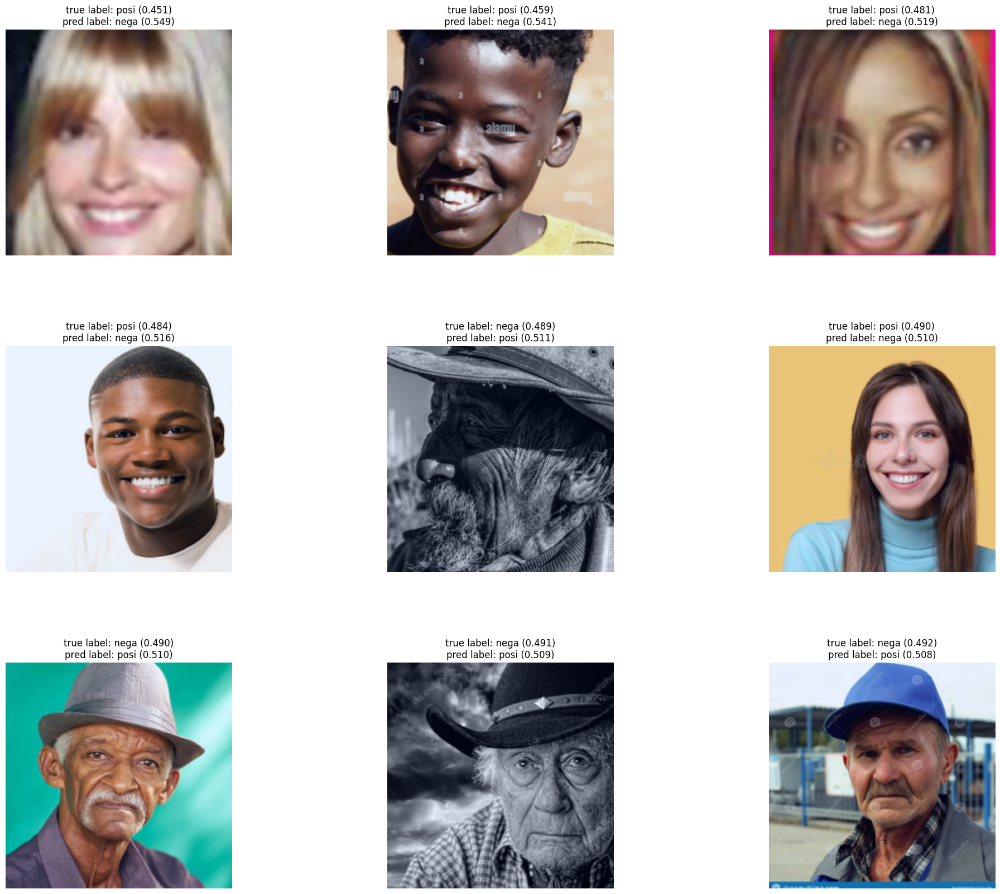

In [52]:
N_IMAGES = len(incorrect_examples)

plot_most_incorrect(incorrect_examples, classes, N_IMAGES)

#### k_tre

In [53]:
testa_dir=name_dir+'/featureexploredataset/test/k_tre'
BATCH_SIZEa=1
testa_data = datasets.ImageFolder(root = testa_dir,
                                 transform = test_transforms)
testa_iterator = data.DataLoader(testa_data,
                                batch_size = BATCH_SIZEa)

In [54]:
def get_predictions(model, iterator):

    model.eval()

    images = []
    labels = []
    probs = []

    with torch.no_grad():

        for (x, y) in iterator:

            x = x.to(device)

            yhat, _ = model(x)

            y_pred_ensemble= torch.stack(torch.chunk(yhat, SAMPLES, dim=-1)).softmax(dim=-1)
            y_pred=y_pred_ensemble.mean(dim=0)######################################svgd
            # y_pred=(y_pred_ensemble[2]+y_pred_ensemble[2])/2.0######################################svgd


            y_prob = F.softmax(y_pred, dim = -1)
            top_pred = y_prob.argmax(1, keepdim = True)

            images.append(x.cpu())
            labels.append(y.cpu())
            probs.append(y_prob.cpu())

    images = torch.cat(images, dim = 0)
    labels = torch.cat(labels, dim = 0)
    probs = torch.cat(probs, dim = 0)

    return images, labels, probs

In [55]:
images, labels, probs = get_predictions(model, testa_iterator)
pred_labels = torch.argmax(probs, 1)

In [56]:
corrects = torch.eq(labels, pred_labels)
corrects

tensor([ True, False,  True,  True, False,  True,  True, False, False,  True,
        False, False,  True,  True,  True,  True, False, False])

In [57]:
len(corrects)- torch.sum(corrects)

tensor(8)

In [58]:
corrects.float().mean()


tensor(0.5556)

In [59]:
incorrect_examples = []

for image, label, prob, correct in zip(images, labels, probs, corrects):
    if not correct:
        incorrect_examples.append((image, label, prob))

incorrect_examples.sort(reverse = True, key = lambda x: torch.max(x[2], dim = 0).values)

In [60]:
incorrect_examples

[(tensor([[[ 2.2489,  2.2489,  2.2489,  ...,  2.0948,  2.0948,  2.0948],
           [ 2.2318,  2.2318,  2.2318,  ...,  2.0777,  2.0777,  2.0777],
           [ 2.2147,  2.2147,  2.2147,  ...,  2.0777,  2.0777,  2.0777],
           ...,
           [ 0.1597,  0.1768,  0.2111,  ..., -0.5424, -0.6623, -0.7479],
           [ 0.8618,  0.8618,  0.8789,  ...,  0.4166,  0.3309,  0.2796],
           [ 1.4612,  1.4612,  1.4783,  ...,  1.2385,  1.2043,  1.1700]],
  
          [[ 2.4286,  2.4286,  2.4286,  ...,  2.3235,  2.3410,  2.3410],
           [ 2.4111,  2.4111,  2.4111,  ...,  2.3410,  2.3585,  2.3585],
           [ 2.3936,  2.3936,  2.3936,  ...,  2.3410,  2.3585,  2.3585],
           ...,
           [ 0.4153,  0.4153,  0.4503,  ..., -0.4426, -0.5651, -0.6527],
           [ 1.0805,  1.0805,  1.0980,  ...,  0.5378,  0.4503,  0.3978],
           [ 1.6758,  1.6758,  1.6758,  ...,  1.3782,  1.3431,  1.3081]],
  
          [[ 2.6400,  2.6400,  2.6400,  ...,  2.3088,  2.3088,  2.3088],
           

In [61]:
count=0
for i in incorrect_examples:
  if(max(i[2].numpy())>=0.6):
    count+=1
print(count)
print(len(incorrect_examples))
count/len(incorrect_examples)

0
8


0.0

In [62]:
def plot_most_incorrect(incorrect, classes, n_images, normalize = True):

    rows = int(np.sqrt(n_images))
    cols = int(np.sqrt(n_images))

    fig = plt.figure(figsize = (25, 20))

    for i in range(rows*cols):

        ax = fig.add_subplot(rows, cols, i+1)

        image, true_label, probs = incorrect[i]
        image = image.permute(1, 2, 0)
        true_prob = probs[true_label]
        incorrect_prob, incorrect_label = torch.max(probs, dim = 0)
        true_class = classes[true_label]
        incorrect_class = classes[incorrect_label]

        if normalize:
            image = normalize_image(image)

        ax.imshow(image.cpu().numpy())
        ax.set_title(f'true label: {true_class} ({true_prob:.3f})\n' \
                     f'pred label: {incorrect_class} ({incorrect_prob:.3f})')
        ax.axis('off')

    fig.subplots_adjust(hspace=0.4)

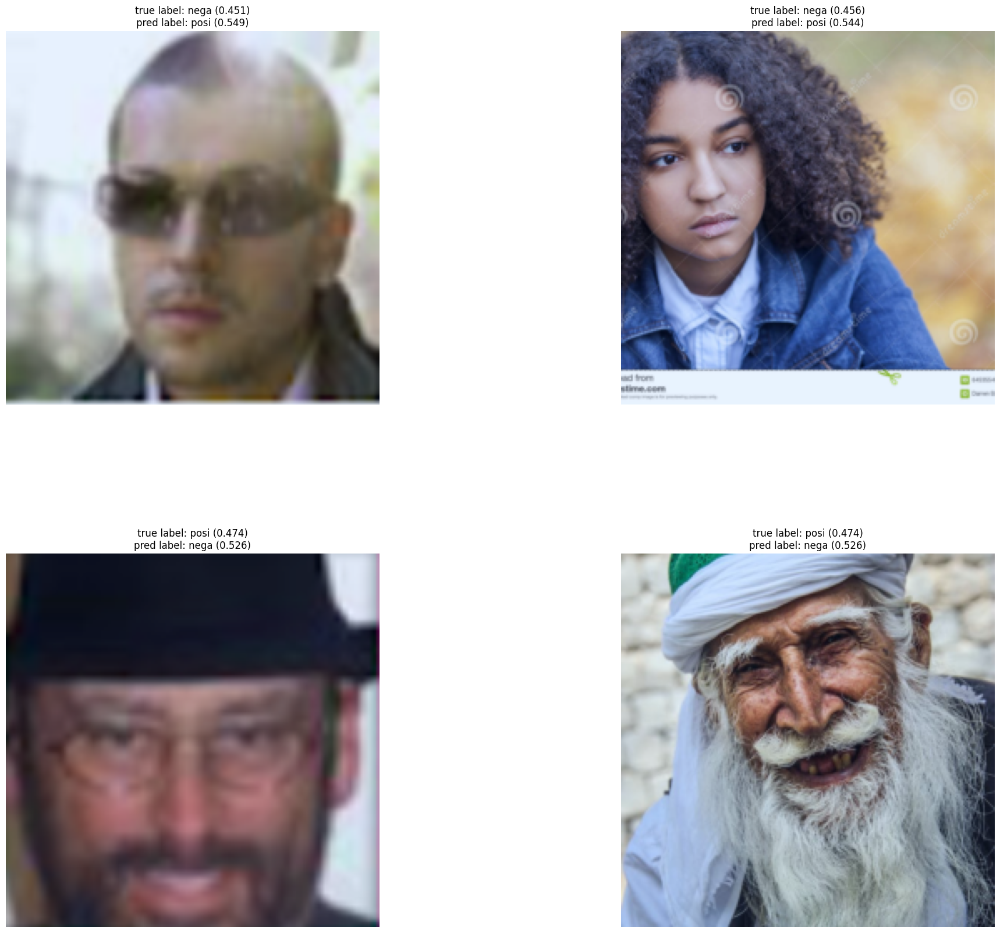

In [63]:
N_IMAGES = len(incorrect_examples)####(labels)

plot_most_incorrect(incorrect_examples, classes, N_IMAGES)

#### k cuoi

In [64]:
testa_dir=name_dir+'/featureexploredataset/test/kcuoi'
# testa_dir='/content/drive/MyDrive/ambidata/featureexploredataset/testtrain'
BATCH_SIZEa=1
testa_data = datasets.ImageFolder(root = testa_dir,
                                 transform = test_transforms)
testa_iterator = data.DataLoader(testa_data,
                                batch_size = BATCH_SIZEa)

In [65]:
def get_predictions(model, iterator):

    model.eval()

    images = []
    labels = []
    probs = []

    with torch.no_grad():

        for (x, y) in iterator:

            x = x.to(device)

            yhat, _ = model(x)

            y_pred_ensemble= torch.stack(torch.chunk(yhat, SAMPLES, dim=-1)).softmax(dim=-1)
            y_pred=y_pred_ensemble.mean(dim=0)######################################svgd
            # y_pred=(y_pred_ensemble[2]+y_pred_ensemble[2])/2.0######################################svgd


            y_prob = F.softmax(y_pred, dim = -1)
            top_pred = y_prob.argmax(1, keepdim = True)

            images.append(x.cpu())
            labels.append(y.cpu())
            probs.append(y_prob.cpu())

    images = torch.cat(images, dim = 0)
    labels = torch.cat(labels, dim = 0)
    probs = torch.cat(probs, dim = 0)

    return images, labels, probs

In [66]:
images, labels, probs = get_predictions(model, testa_iterator)
pred_labels = torch.argmax(probs, 1)

In [67]:
corrects = torch.eq(labels, pred_labels)
corrects

tensor([ True,  True,  True,  True,  True,  True,  True,  True,  True,  True,
        False,  True,  True, False,  True,  True,  True,  True, False,  True,
         True,  True,  True,  True,  True,  True,  True,  True,  True,  True,
         True,  True, False,  True,  True,  True,  True, False,  True,  True,
         True,  True,  True,  True, False,  True,  True,  True,  True,  True,
        False, False,  True])

In [68]:
len(corrects)- torch.sum(corrects)

tensor(8)

In [69]:
corrects.float().mean()

tensor(0.8491)

In [70]:
incorrect_examples = []

for image, label, prob, correct in zip(images, labels, probs, corrects):
    if not correct:########## cmt nếu muốn show all
        incorrect_examples.append((image, label, prob))

incorrect_examples.sort(reverse = True, key = lambda x: torch.max(x[2], dim = 0).values)

In [71]:
incorrect_examples

[(tensor([[[1.1358, 1.1358, 1.1358,  ..., 0.8961, 0.9132, 0.8961],
           [1.1358, 1.1529, 1.1529,  ..., 0.8961, 0.9132, 0.9132],
           [1.1358, 1.1529, 1.1700,  ..., 0.9132, 0.9132, 0.9303],
           ...,
           [1.0844, 1.1015, 1.1358,  ..., 0.9303, 0.9646, 0.9132],
           [1.0331, 1.0502, 1.0673,  ..., 0.8789, 0.8789, 0.7762],
           [0.9646, 1.0159, 1.0331,  ..., 0.8447, 0.8276, 0.7591]],
  
          [[1.2906, 1.2906, 1.2906,  ..., 1.0455, 1.0630, 1.0455],
           [1.2906, 1.3081, 1.3081,  ..., 1.0455, 1.0630, 1.0630],
           [1.2906, 1.3081, 1.3256,  ..., 1.0630, 1.0630, 1.0805],
           ...,
           [1.2906, 1.3081, 1.3431,  ..., 1.1506, 1.1681, 1.1681],
           [1.2556, 1.2731, 1.2906,  ..., 1.0980, 1.0980, 1.0630],
           [1.1681, 1.2206, 1.2556,  ..., 1.0630, 1.0630, 1.0105]],
  
          [[1.5071, 1.5071, 1.5071,  ..., 1.2631, 1.2805, 1.2631],
           [1.5071, 1.5245, 1.5245,  ..., 1.2631, 1.2805, 1.2805],
           [1.5071, 1.

In [72]:
count=0
for i in incorrect_examples:
  if(max(i[2].numpy())>=0.6):
    count+=1
print(count)
print(len(incorrect_examples))
count/len(incorrect_examples)

0
8


0.0

In [73]:
def plot_most_incorrect(incorrect, classes, n_images, normalize = True):

    rows = int(np.sqrt(n_images))
    cols = int(np.sqrt(n_images))

    fig = plt.figure(figsize = (25, 20))

    for i in range(rows*cols):

        ax = fig.add_subplot(rows, cols, i+1)

        image, true_label, probs = incorrect[i]
        image = image.permute(1, 2, 0)
        true_prob = probs[true_label]
        incorrect_prob, incorrect_label = torch.max(probs, dim = 0)
        true_class = classes[true_label]
        incorrect_class = classes[incorrect_label]

        if normalize:
            image = normalize_image(image)

        ax.imshow(image.cpu().numpy())
        ax.set_title(f'true label: {true_class} ({true_prob:.3f})\n' \
                     f'pred label: {incorrect_class} ({incorrect_prob:.3f})')
        ax.axis('off')

    fig.subplots_adjust(hspace=0.4)

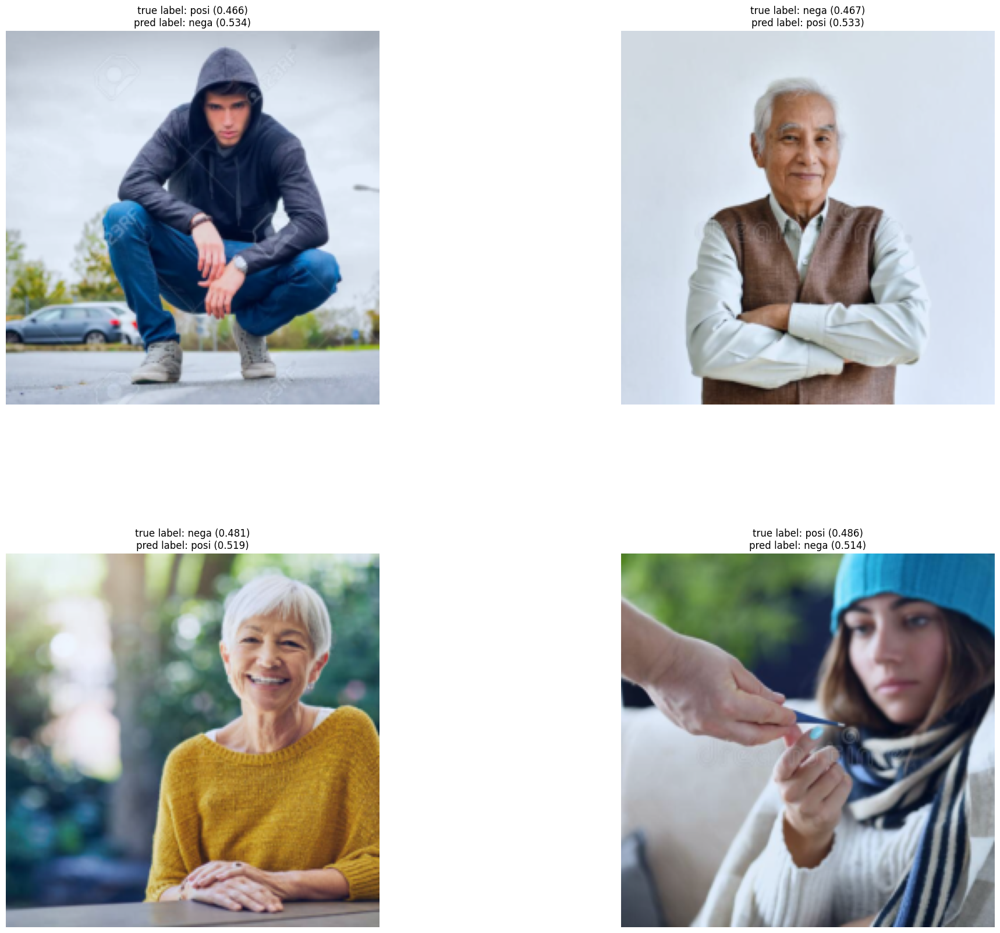

In [74]:
N_IMAGES = len(incorrect_examples)

plot_most_incorrect(incorrect_examples, classes, N_IMAGES)

## disambiguate

#### k doi mu

In [75]:
testa_dir=name_dir+'/featureexploredataset/test/k_doi_mu'
BATCH_SIZEa=1
testa_data = datasets.ImageFolder(root = testa_dir,
                                 transform = test_transforms)
testa_iterator = data.DataLoader(testa_data,
                                batch_size = BATCH_SIZEa)

In [76]:
def get_predictions(model, iterator):

    model.eval()

    images = []
    labels = []
    probs = []

    with torch.no_grad():

        for (x, y) in iterator:

            x = x.to(device)

            yhat, _ = model(x)

            y_pred_ensemble= torch.stack(torch.chunk(yhat, SAMPLES, dim=-1)).softmax(dim=-1)
            # y_pred=y_pred_ensemble.mean(dim=0)######################################svgd
            y_pred=(y_pred_ensemble[0]+y_pred_ensemble[2])/2.0######################################svgd


            y_prob = F.softmax(y_pred, dim = -1)
            top_pred = y_prob.argmax(1, keepdim = True)

            images.append(x.cpu())
            labels.append(y.cpu())
            probs.append(y_prob.cpu())

    images = torch.cat(images, dim = 0)
    labels = torch.cat(labels, dim = 0)
    probs = torch.cat(probs, dim = 0)

    return images, labels, probs

In [77]:
images, labels, probs = get_predictions(model, testa_iterator)
pred_labels = torch.argmax(probs, 1)

In [78]:
corrects = torch.eq(labels, pred_labels)
corrects

tensor([ True,  True, False,  True, False,  True, False, False, False,  True,
        False, False,  True,  True, False, False, False, False,  True,  True,
        False,  True,  True,  True, False,  True,  True])

In [79]:
len(corrects)- torch.sum(corrects)

tensor(13)

In [80]:
corrects.float().mean()

tensor(0.5185)

In [81]:
incorrect_examples = []

for image, label, prob, correct in zip(images, labels, probs, corrects):
    if not correct:########## cmt nếu muốn show all
        incorrect_examples.append((image, label, prob))

incorrect_examples.sort(reverse = True, key = lambda x: torch.max(x[2], dim = 0).values)

In [82]:
incorrect_examples

[(tensor([[[-2.0494, -2.0323, -2.0152,  ..., -0.3369, -0.5253, -0.6281],
           [-2.0494, -2.0323, -2.0152,  ..., -0.2513, -0.4397, -0.5424],
           [-2.0494, -2.0323, -2.0152,  ..., -0.1657, -0.3541, -0.4568],
           ...,
           [-1.7754, -1.7240, -1.6384,  ...,  0.6221,  0.6221,  0.6221],
           [-1.7925, -1.7412, -1.6555,  ...,  0.5536,  0.5707,  0.5707],
           [-1.8097, -1.7583, -1.6898,  ...,  0.4679,  0.4851,  0.5022]],
  
          [[-1.9657, -1.9482, -1.9307,  ..., -0.4251, -0.5651, -0.6352],
           [-1.9657, -1.9482, -1.9307,  ..., -0.3550, -0.4951, -0.5651],
           [-1.9657, -1.9482, -1.9307,  ..., -0.2675, -0.4076, -0.4951],
           ...,
           [-1.7206, -1.6856, -1.5980,  ...,  0.1176,  0.1527,  0.1527],
           [-1.7381, -1.6856, -1.6155,  ...,  0.0476,  0.1001,  0.1176],
           [-1.7381, -1.7031, -1.6155,  ..., -0.0224,  0.0301,  0.0651]],
  
          [[-1.7347, -1.7173, -1.6999,  ..., -0.5495, -0.7238, -0.8110],
           

In [83]:
count=0
for i in incorrect_examples:
  if(max(i[2].numpy())>=0.6):
    count+=1
print(count)
print(len(incorrect_examples))
count/len(incorrect_examples)

0
13


0.0

In [84]:
def plot_most_incorrect(incorrect, classes, n_images, normalize = True):

    rows = int(np.sqrt(n_images))
    cols = int(np.sqrt(n_images))

    fig = plt.figure(figsize = (25, 20))

    for i in range(rows*cols):

        ax = fig.add_subplot(rows, cols, i+1)

        image, true_label, probs = incorrect[i]
        image = image.permute(1, 2, 0)
        true_prob = probs[true_label]
        incorrect_prob, incorrect_label = torch.max(probs, dim = 0)
        true_class = classes[true_label]
        incorrect_class = classes[incorrect_label]

        if normalize:
            image = normalize_image(image)

        ax.imshow(image.cpu().numpy())
        ax.set_title(f'true label: {true_class} ({true_prob:.3f})\n' \
                     f'pred label: {incorrect_class} ({incorrect_prob:.3f})')
        ax.axis('off')

    fig.subplots_adjust(hspace=0.4)

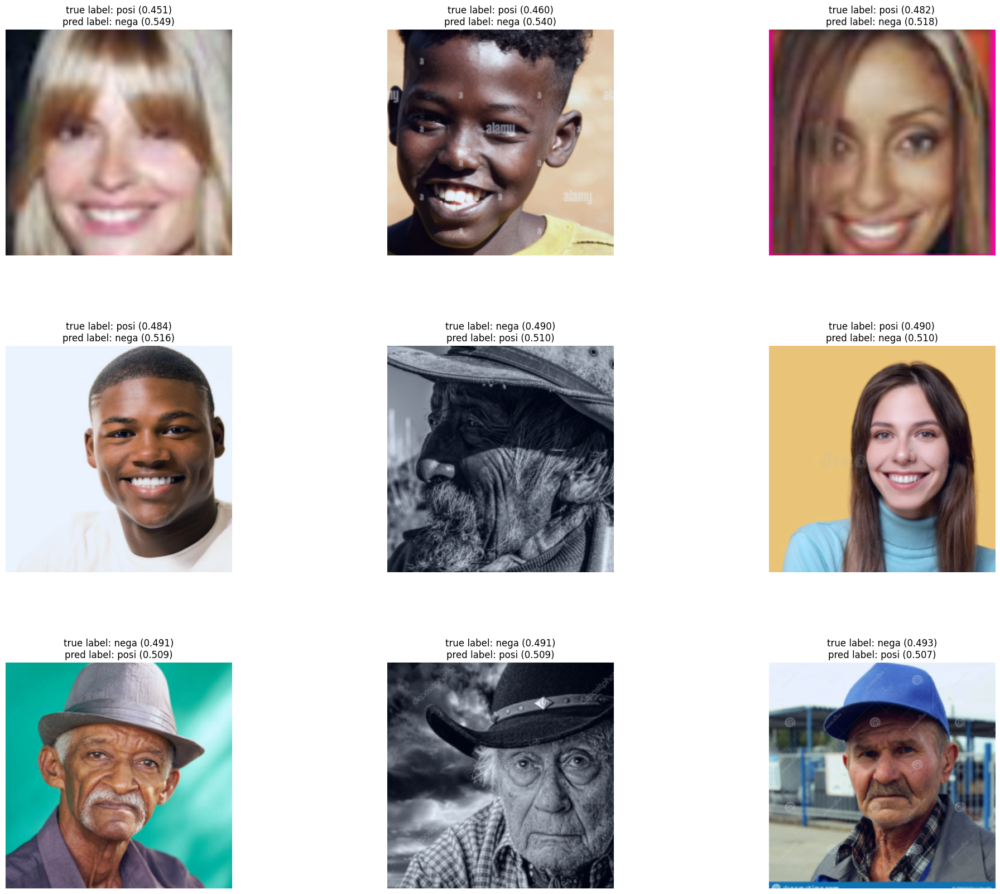

In [85]:
N_IMAGES = len(incorrect_examples)

plot_most_incorrect(incorrect_examples, classes, N_IMAGES)

#### k_tre

In [86]:
testa_dir=name_dir+'/featureexploredataset/test/k_tre'
BATCH_SIZEa=1
testa_data = datasets.ImageFolder(root = testa_dir,
                                 transform = test_transforms)
testa_iterator = data.DataLoader(testa_data,
                                batch_size = BATCH_SIZEa)

In [87]:
def get_predictions(model, iterator):

    model.eval()

    images = []
    labels = []
    probs = []

    with torch.no_grad():

        for (x, y) in iterator:

            x = x.to(device)

            yhat, _ = model(x)

            y_pred_ensemble= torch.stack(torch.chunk(yhat, SAMPLES, dim=-1)).softmax(dim=-1)
            # y_pred=y_pred_ensemble.mean(dim=0)######################################svgd
            y_pred=(y_pred_ensemble[1]+y_pred_ensemble[1])/2.0######################################svgd


            y_prob = F.softmax(y_pred, dim = -1)
            top_pred = y_prob.argmax(1, keepdim = True)

            images.append(x.cpu())
            labels.append(y.cpu())
            probs.append(y_prob.cpu())

    images = torch.cat(images, dim = 0)
    labels = torch.cat(labels, dim = 0)
    probs = torch.cat(probs, dim = 0)

    return images, labels, probs

In [88]:
images, labels, probs = get_predictions(model, testa_iterator)
pred_labels = torch.argmax(probs, 1)

In [89]:
corrects = torch.eq(labels, pred_labels)
corrects

tensor([ True, False,  True, False, False,  True,  True, False, False,  True,
        False, False,  True,  True,  True,  True, False, False])

In [90]:
len(corrects)- torch.sum(corrects)

tensor(9)

In [91]:
corrects.float().mean()


tensor(0.5000)

In [92]:
incorrect_examples = []

for image, label, prob, correct in zip(images, labels, probs, corrects):
    if not correct:
        incorrect_examples.append((image, label, prob))

incorrect_examples.sort(reverse = True, key = lambda x: torch.max(x[2], dim = 0).values)

In [93]:
incorrect_examples

[(tensor([[[ 2.2489,  2.2489,  2.2489,  ...,  2.0948,  2.0948,  2.0948],
           [ 2.2318,  2.2318,  2.2318,  ...,  2.0777,  2.0777,  2.0777],
           [ 2.2147,  2.2147,  2.2147,  ...,  2.0777,  2.0777,  2.0777],
           ...,
           [ 0.1597,  0.1768,  0.2111,  ..., -0.5424, -0.6623, -0.7479],
           [ 0.8618,  0.8618,  0.8789,  ...,  0.4166,  0.3309,  0.2796],
           [ 1.4612,  1.4612,  1.4783,  ...,  1.2385,  1.2043,  1.1700]],
  
          [[ 2.4286,  2.4286,  2.4286,  ...,  2.3235,  2.3410,  2.3410],
           [ 2.4111,  2.4111,  2.4111,  ...,  2.3410,  2.3585,  2.3585],
           [ 2.3936,  2.3936,  2.3936,  ...,  2.3410,  2.3585,  2.3585],
           ...,
           [ 0.4153,  0.4153,  0.4503,  ..., -0.4426, -0.5651, -0.6527],
           [ 1.0805,  1.0805,  1.0980,  ...,  0.5378,  0.4503,  0.3978],
           [ 1.6758,  1.6758,  1.6758,  ...,  1.3782,  1.3431,  1.3081]],
  
          [[ 2.6400,  2.6400,  2.6400,  ...,  2.3088,  2.3088,  2.3088],
           

In [94]:
count=0
for i in incorrect_examples:
  if(max(i[2].numpy())>=0.6):
    count+=1
print(count)
print(len(incorrect_examples))
count/len(incorrect_examples)

0
9


0.0

In [95]:
def plot_most_incorrect(incorrect, classes, n_images, normalize = True):

    rows = int(np.sqrt(n_images))
    cols = int(np.sqrt(n_images))

    fig = plt.figure(figsize = (25, 20))

    for i in range(rows*cols):

        ax = fig.add_subplot(rows, cols, i+1)

        image, true_label, probs = incorrect[i]
        image = image.permute(1, 2, 0)
        true_prob = probs[true_label]
        incorrect_prob, incorrect_label = torch.max(probs, dim = 0)
        true_class = classes[true_label]
        incorrect_class = classes[incorrect_label]

        if normalize:
            image = normalize_image(image)

        ax.imshow(image.cpu().numpy())
        ax.set_title(f'true label: {true_class} ({true_prob:.3f})\n' \
                     f'pred label: {incorrect_class} ({incorrect_prob:.3f})')
        ax.axis('off')

    fig.subplots_adjust(hspace=0.4)

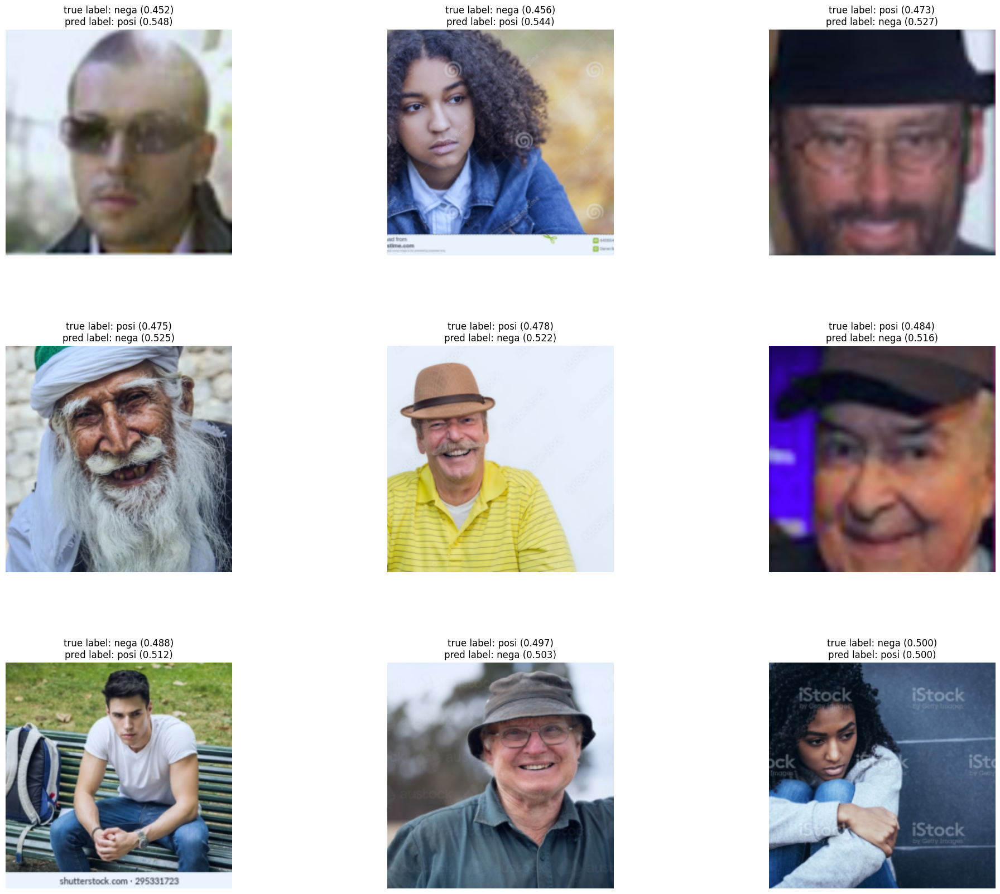

In [96]:
N_IMAGES = len(incorrect_examples)####(labels)

plot_most_incorrect(incorrect_examples, classes, N_IMAGES)

#### k cuoi

In [97]:
testa_dir=name_dir+'/featureexploredataset/test/kcuoi'
# testa_dir='/content/drive/MyDrive/ambidata/featureexploredataset/testtrain'
BATCH_SIZEa=1
testa_data = datasets.ImageFolder(root = testa_dir,
                                 transform = test_transforms)
testa_iterator = data.DataLoader(testa_data,
                                batch_size = BATCH_SIZEa)

In [98]:
def get_predictions(model, iterator):

    model.eval()

    images = []
    labels = []
    probs = []

    with torch.no_grad():

        for (x, y) in iterator:

            x = x.to(device)

            yhat, _ = model(x)

            y_pred_ensemble= torch.stack(torch.chunk(yhat, SAMPLES, dim=-1)).softmax(dim=-1)
            # y_pred=y_pred_ensemble.mean(dim=0)######################################svgd
            y_pred=(y_pred_ensemble[2]+y_pred_ensemble[2])/2.0######################################svgd


            y_prob = F.softmax(y_pred, dim = -1)
            top_pred = y_prob.argmax(1, keepdim = True)

            images.append(x.cpu())
            labels.append(y.cpu())
            probs.append(y_prob.cpu())

    images = torch.cat(images, dim = 0)
    labels = torch.cat(labels, dim = 0)
    probs = torch.cat(probs, dim = 0)

    return images, labels, probs

In [99]:
images, labels, probs = get_predictions(model, testa_iterator)
pred_labels = torch.argmax(probs, 1)

In [100]:
corrects = torch.eq(labels, pred_labels)
corrects

tensor([ True,  True,  True,  True,  True,  True,  True,  True,  True,  True,
        False,  True,  True, False,  True,  True,  True,  True, False,  True,
         True,  True,  True,  True,  True,  True,  True,  True,  True,  True,
         True,  True, False,  True,  True,  True,  True, False,  True,  True,
         True,  True,  True,  True, False,  True,  True,  True,  True,  True,
        False, False,  True])

In [101]:
len(corrects)- torch.sum(corrects)

tensor(8)

In [102]:
corrects.float().mean()

tensor(0.8491)

In [103]:
incorrect_examples = []

for image, label, prob, correct in zip(images, labels, probs, corrects):
    if not correct:########## cmt nếu muốn show all
        incorrect_examples.append((image, label, prob))

incorrect_examples.sort(reverse = True, key = lambda x: torch.max(x[2], dim = 0).values)

In [104]:
incorrect_examples

[(tensor([[[1.1358, 1.1358, 1.1358,  ..., 0.8961, 0.9132, 0.8961],
           [1.1358, 1.1529, 1.1529,  ..., 0.8961, 0.9132, 0.9132],
           [1.1358, 1.1529, 1.1700,  ..., 0.9132, 0.9132, 0.9303],
           ...,
           [1.0844, 1.1015, 1.1358,  ..., 0.9303, 0.9646, 0.9132],
           [1.0331, 1.0502, 1.0673,  ..., 0.8789, 0.8789, 0.7762],
           [0.9646, 1.0159, 1.0331,  ..., 0.8447, 0.8276, 0.7591]],
  
          [[1.2906, 1.2906, 1.2906,  ..., 1.0455, 1.0630, 1.0455],
           [1.2906, 1.3081, 1.3081,  ..., 1.0455, 1.0630, 1.0630],
           [1.2906, 1.3081, 1.3256,  ..., 1.0630, 1.0630, 1.0805],
           ...,
           [1.2906, 1.3081, 1.3431,  ..., 1.1506, 1.1681, 1.1681],
           [1.2556, 1.2731, 1.2906,  ..., 1.0980, 1.0980, 1.0630],
           [1.1681, 1.2206, 1.2556,  ..., 1.0630, 1.0630, 1.0105]],
  
          [[1.5071, 1.5071, 1.5071,  ..., 1.2631, 1.2805, 1.2631],
           [1.5071, 1.5245, 1.5245,  ..., 1.2631, 1.2805, 1.2805],
           [1.5071, 1.

In [105]:
count=0
for i in incorrect_examples:
  if(max(i[2].numpy())>=0.6):
    count+=1
print(count)
print(len(incorrect_examples))
count/len(incorrect_examples)

0
8


0.0

In [106]:
def plot_most_incorrect(incorrect, classes, n_images, normalize = True):

    rows = int(np.sqrt(n_images))
    cols = int(np.sqrt(n_images))

    fig = plt.figure(figsize = (25, 20))

    for i in range(rows*cols):

        ax = fig.add_subplot(rows, cols, i+1)

        image, true_label, probs = incorrect[i]
        image = image.permute(1, 2, 0)
        true_prob = probs[true_label]
        incorrect_prob, incorrect_label = torch.max(probs, dim = 0)
        true_class = classes[true_label]
        incorrect_class = classes[incorrect_label]

        if normalize:
            image = normalize_image(image)

        ax.imshow(image.cpu().numpy())
        ax.set_title(f'true label: {true_class} ({true_prob:.3f})\n' \
                     f'pred label: {incorrect_class} ({incorrect_prob:.3f})')
        ax.axis('off')

    fig.subplots_adjust(hspace=0.4)

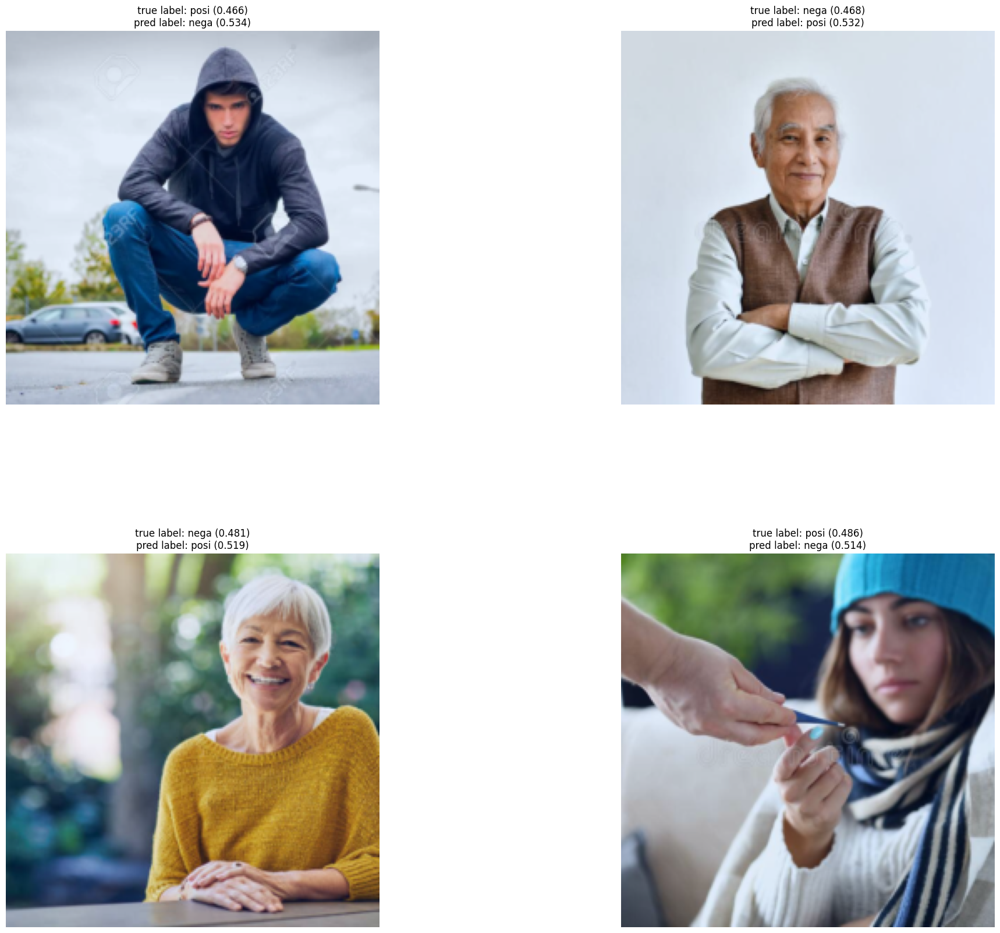

In [107]:
N_IMAGES = len(incorrect_examples)

plot_most_incorrect(incorrect_examples, classes, N_IMAGES)

## Target test

#### k doi mu

In [108]:
testa_dir=name_dir+'/featureexploredataset/targettest/k_doi_mu'
BATCH_SIZEa=1
testa_data = datasets.ImageFolder(root = testa_dir,
                                 transform = test_transforms)
testa_iterator = data.DataLoader(testa_data,
                                batch_size = BATCH_SIZEa)

In [109]:
def get_predictions(model, iterator):

    model.eval()

    images = []
    labels = []
    probs = []

    with torch.no_grad():

        for (x, y) in iterator:

            x = x.to(device)

            yhat, _ = model(x)

            y_pred_ensemble= torch.stack(torch.chunk(yhat, SAMPLES, dim=-1)).softmax(dim=-1)
            y_pred=y_pred_ensemble.mean(dim=0)######################################svgd
            # y_pred=(y_pred_ensemble[2]+y_pred_ensemble[2])/2.0######################################svgd


            y_prob = F.softmax(y_pred, dim = -1)
            top_pred = y_prob.argmax(1, keepdim = True)

            images.append(x.cpu())
            labels.append(y.cpu())
            probs.append(y_prob.cpu())

    images = torch.cat(images, dim = 0)
    labels = torch.cat(labels, dim = 0)
    probs = torch.cat(probs, dim = 0)

    return images, labels, probs

In [110]:
images, labels, probs = get_predictions(model, testa_iterator)
pred_labels = torch.argmax(probs, 1)

In [111]:
corrects = torch.eq(labels, pred_labels)
corrects

tensor([ True,  True, False,  True,  True, False,  True, False,  True, False,
        False,  True,  True,  True,  True,  True,  True, False,  True, False,
        False,  True, False,  True, False, False, False, False,  True,  True,
         True, False,  True, False,  True, False, False,  True,  True, False,
        False, False, False, False,  True, False,  True,  True,  True,  True,
        False, False, False,  True, False,  True,  True,  True,  True,  True,
        False, False,  True,  True, False,  True, False, False, False,  True,
        False,  True, False,  True, False, False,  True,  True, False,  True,
         True, False,  True,  True, False, False,  True,  True,  True,  True,
         True,  True, False, False,  True,  True,  True, False,  True,  True,
        False, False,  True,  True,  True,  True,  True,  True,  True,  True,
        False,  True,  True,  True, False,  True,  True,  True,  True,  True,
        False, False,  True,  True, False,  True,  True,  True, 

In [112]:
len(corrects)- torch.sum(corrects)

tensor(57)

In [113]:
corrects.float().mean()

tensor(0.7246)

In [114]:
incorrect_examples = []

for image, label, prob, correct in zip(images, labels, probs, corrects):
    if not correct:########## cmt nếu muốn show all
        incorrect_examples.append((image, label, prob))

incorrect_examples.sort(reverse = True, key = lambda x: torch.max(x[2], dim = 0).values)

In [115]:
incorrect_examples

[(tensor([[[ 1.1700,  1.2043,  1.2043,  ...,  1.2214,  1.2214,  1.2214],
           [ 1.1700,  1.2043,  1.2043,  ...,  1.2214,  1.2214,  1.2214],
           [ 1.1700,  1.2043,  1.2043,  ...,  1.2214,  1.2214,  1.2214],
           ...,
           [ 0.5364,  0.8618,  1.3755,  ...,  0.9303,  0.8618,  0.7933],
           [-0.3369, -0.6794,  0.1768,  ...,  0.8961,  0.8276,  0.7591],
           [-0.5767, -1.1589, -0.7479,  ...,  0.8961,  0.8276,  0.7591]],
  
          [[ 1.5007,  1.5357,  1.5357,  ...,  1.5532,  1.5532,  1.5532],
           [ 1.5007,  1.5357,  1.5357,  ...,  1.5532,  1.5532,  1.5532],
           [ 1.5007,  1.5357,  1.5357,  ...,  1.5532,  1.5532,  1.5532],
           ...,
           [ 0.9580,  1.4482,  2.0259,  ...,  1.3606,  1.3256,  1.2556],
           [ 0.1176, -0.0574,  0.8880,  ...,  1.3256,  1.2906,  1.2206],
           [-0.0749, -0.5126, -0.0399,  ...,  1.3256,  1.2906,  1.2206]],
  
          [[ 1.7511,  1.7860,  1.7860,  ...,  1.8034,  1.8034,  1.8034],
           

In [116]:
count=0
for i in incorrect_examples:
  if(max(i[2].numpy())>=0.6):
    count+=1
print(count)
print(len(incorrect_examples))
count/len(incorrect_examples)

0
57


0.0

In [117]:
def plot_most_incorrect(incorrect, classes, n_images, normalize = True):

    rows = int(np.sqrt(n_images))
    cols = int(np.sqrt(n_images))

    fig = plt.figure(figsize = (25, 20))

    for i in range(rows*cols):

        ax = fig.add_subplot(rows, cols, i+1)

        image, true_label, probs = incorrect[i]
        image = image.permute(1, 2, 0)
        true_prob = probs[true_label]
        incorrect_prob, incorrect_label = torch.max(probs, dim = 0)
        true_class = classes[true_label]
        incorrect_class = classes[incorrect_label]

        if normalize:
            image = normalize_image(image)

        ax.imshow(image.cpu().numpy())
        ax.set_title(f'true label: {true_class} ({true_prob:.3f})\n' \
                     f'pred label: {incorrect_class} ({incorrect_prob:.3f})')
        ax.axis('off')

    fig.subplots_adjust(hspace=0.4)

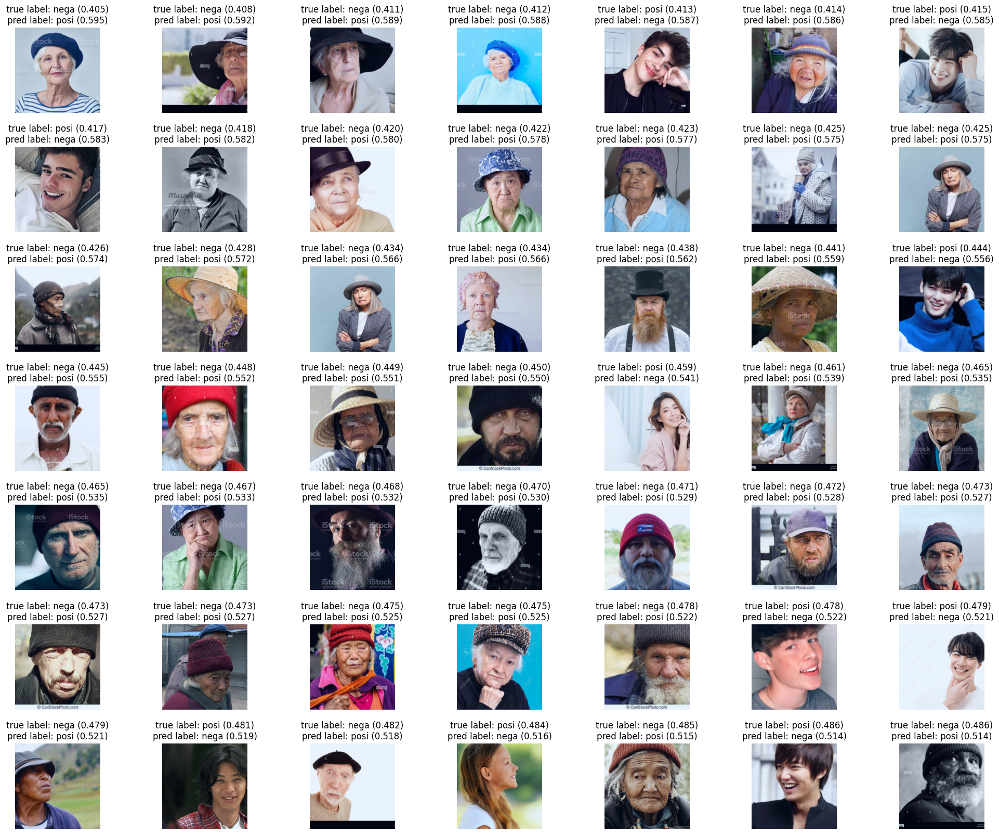

In [118]:
N_IMAGES = len(incorrect_examples)

plot_most_incorrect(incorrect_examples, classes, N_IMAGES)

#### k_tre

In [119]:
testa_dir=name_dir+'/featureexploredataset/targettest/k_tre'
BATCH_SIZEa=1
testa_data = datasets.ImageFolder(root = testa_dir,
                                 transform = test_transforms)
testa_iterator = data.DataLoader(testa_data,
                                batch_size = BATCH_SIZEa)

In [120]:
def get_predictions(model, iterator):

    model.eval()

    images = []
    labels = []
    probs = []

    with torch.no_grad():

        for (x, y) in iterator:

            x = x.to(device)

            yhat, _ = model(x)

            y_pred_ensemble= torch.stack(torch.chunk(yhat, SAMPLES, dim=-1)).softmax(dim=-1)
            y_pred=y_pred_ensemble.mean(dim=0)######################################svgd
            # y_pred=(y_pred_ensemble[2]+y_pred_ensemble[2])/2.0######################################svgd


            y_prob = F.softmax(y_pred, dim = -1)
            top_pred = y_prob.argmax(1, keepdim = True)

            images.append(x.cpu())
            labels.append(y.cpu())
            probs.append(y_prob.cpu())

    images = torch.cat(images, dim = 0)
    labels = torch.cat(labels, dim = 0)
    probs = torch.cat(probs, dim = 0)

    return images, labels, probs

In [121]:
images, labels, probs = get_predictions(model, testa_iterator)
pred_labels = torch.argmax(probs, 1)

In [122]:
corrects = torch.eq(labels, pred_labels)
corrects

tensor([False, False,  True, False, False, False, False, False,  True,  True,
         True, False, False,  True,  True, False, False,  True,  True,  True,
        False, False,  True,  True,  True,  True, False,  True, False, False,
         True,  True, False,  True, False,  True, False, False,  True, False,
         True,  True, False, False, False, False, False, False,  True, False,
         True,  True, False,  True, False, False, False,  True,  True, False,
        False,  True, False,  True,  True,  True, False,  True, False, False,
        False,  True,  True, False,  True,  True, False, False, False, False,
         True,  True,  True, False, False,  True,  True,  True, False,  True,
        False, False, False,  True,  True,  True,  True, False, False,  True,
         True, False, False,  True,  True,  True,  True, False,  True,  True,
         True,  True,  True, False,  True,  True, False,  True,  True,  True,
         True,  True,  True,  True,  True,  True,  True,  True, 

In [123]:
len(corrects)- torch.sum(corrects)

tensor(73)

In [124]:
corrects.float().mean()


tensor(0.6605)

In [125]:
incorrect_examples = []

for image, label, prob, correct in zip(images, labels, probs, corrects):
    if not correct:
        incorrect_examples.append((image, label, prob))

incorrect_examples.sort(reverse = True, key = lambda x: torch.max(x[2], dim = 0).values)

In [126]:
incorrect_examples

[(tensor([[[ 0.5193,  0.4337,  0.3823,  ...,  0.8618,  0.8104,  0.7933],
           [ 0.6906,  0.6221,  0.5536,  ...,  0.9132,  0.8789,  0.8789],
           [ 0.8104,  0.7419,  0.7077,  ...,  0.8961,  0.8961,  0.8961],
           ...,
           [-0.1999, -0.1486, -0.0972,  ...,  0.8104,  0.7933,  0.7933],
           [-0.2684, -0.2684, -0.2684,  ...,  0.8276,  0.8276,  0.8276],
           [-0.3541, -0.3712, -0.3712,  ...,  0.8276,  0.8276,  0.8276]],
  
          [[ 0.3277,  0.2402,  0.1877,  ...,  0.5728,  0.5203,  0.5028],
           [ 0.4678,  0.3978,  0.3277,  ...,  0.6078,  0.5728,  0.5728],
           [ 0.5903,  0.5203,  0.4853,  ...,  0.5903,  0.5903,  0.5903],
           ...,
           [-1.2304, -1.1779, -1.1429,  ...,  0.6604,  0.6429,  0.6429],
           [-1.2654, -1.2654, -1.2654,  ...,  0.6604,  0.6604,  0.6604],
           [-1.3529, -1.3529, -1.3529,  ...,  0.6604,  0.6604,  0.6604]],
  
          [[ 0.0779, -0.0092, -0.1138,  ...,  0.1825,  0.1476,  0.1302],
           

In [127]:
count=0
for i in incorrect_examples:
  if(max(i[2].numpy())>=0.6):
    count+=1
print(count)
print(len(incorrect_examples))
count/len(incorrect_examples)

2
73


0.0273972602739726

In [128]:
def plot_most_incorrect(incorrect, classes, n_images, normalize = True):

    rows = int(np.sqrt(n_images))
    cols = int(np.sqrt(n_images))

    fig = plt.figure(figsize = (25, 20))

    for i in range(rows*cols):

        ax = fig.add_subplot(rows, cols, i+1)

        image, true_label, probs = incorrect[i]
        image = image.permute(1, 2, 0)
        true_prob = probs[true_label]
        incorrect_prob, incorrect_label = torch.max(probs, dim = 0)
        true_class = classes[true_label]
        incorrect_class = classes[incorrect_label]

        if normalize:
            image = normalize_image(image)

        ax.imshow(image.cpu().numpy())
        ax.set_title(f'true label: {true_class} ({true_prob:.3f})\n' \
                     f'pred label: {incorrect_class} ({incorrect_prob:.3f})')
        ax.axis('off')

    fig.subplots_adjust(hspace=0.4)

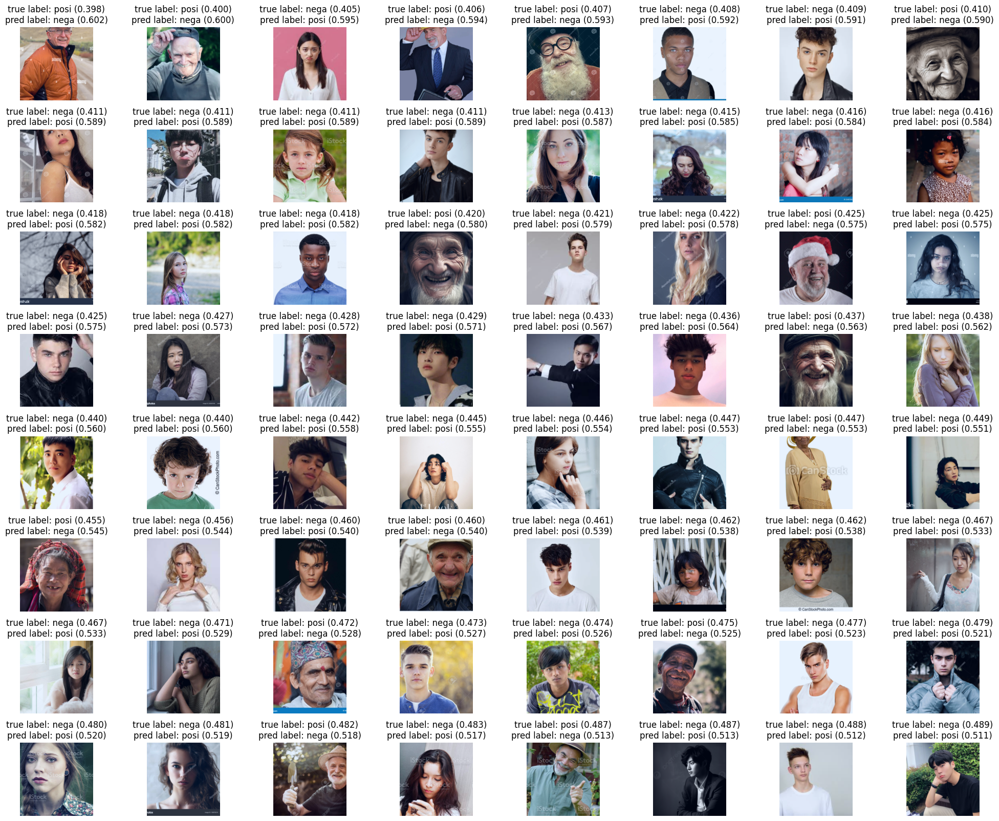

In [129]:
N_IMAGES = len(incorrect_examples)####(labels)

plot_most_incorrect(incorrect_examples, classes, N_IMAGES)

#### k cuoi

In [130]:
testa_dir=name_dir+'/featureexploredataset/targettest/kcuoi'
# testa_dir='/content/drive/MyDrive/ambidata/featureexploredataset/testtrain'
BATCH_SIZEa=1
testa_data = datasets.ImageFolder(root = testa_dir,
                                 transform = test_transforms)
testa_iterator = data.DataLoader(testa_data,
                                batch_size = BATCH_SIZEa)

In [131]:
def get_predictions(model, iterator):

    model.eval()

    images = []
    labels = []
    probs = []

    with torch.no_grad():

        for (x, y) in iterator:

            x = x.to(device)

            yhat, _ = model(x)

            y_pred_ensemble= torch.stack(torch.chunk(yhat, SAMPLES, dim=-1)).softmax(dim=-1)
            y_pred=y_pred_ensemble.mean(dim=0)######################################svgd
            # y_pred=(y_pred_ensemble[2]+y_pred_ensemble[2])/2.0######################################svgd


            y_prob = F.softmax(y_pred, dim = -1)
            top_pred = y_prob.argmax(1, keepdim = True)

            images.append(x.cpu())
            labels.append(y.cpu())
            probs.append(y_prob.cpu())

    images = torch.cat(images, dim = 0)
    labels = torch.cat(labels, dim = 0)
    probs = torch.cat(probs, dim = 0)

    return images, labels, probs

In [132]:
images, labels, probs = get_predictions(model, testa_iterator)
pred_labels = torch.argmax(probs, 1)

In [133]:
corrects = torch.eq(labels, pred_labels)
corrects

tensor([ True, False,  True,  True,  True,  True,  True,  True,  True,  True,
         True, False,  True,  True,  True, False,  True,  True,  True,  True,
         True, False,  True,  True,  True,  True,  True,  True,  True,  True,
         True,  True,  True,  True,  True, False,  True,  True,  True,  True,
         True,  True,  True,  True,  True,  True,  True,  True, False,  True,
         True,  True, False,  True,  True,  True,  True,  True,  True,  True,
         True,  True,  True,  True,  True, False,  True,  True,  True,  True,
         True, False,  True,  True,  True,  True,  True,  True,  True,  True,
        False,  True,  True,  True,  True,  True, False,  True, False,  True,
         True,  True,  True,  True,  True,  True,  True,  True, False,  True,
         True,  True,  True,  True,  True,  True,  True,  True, False,  True,
         True,  True,  True,  True,  True,  True,  True,  True,  True,  True,
         True,  True, False,  True,  True,  True,  True,  True, 

In [134]:
len(corrects)- torch.sum(corrects)

tensor(22)

In [135]:
corrects.float().mean()

tensor(0.8883)

In [136]:
incorrect_examples = []

for image, label, prob, correct in zip(images, labels, probs, corrects):
    if not correct:########## cmt nếu muốn show all
        incorrect_examples.append((image, label, prob))

incorrect_examples.sort(reverse = True, key = lambda x: torch.max(x[2], dim = 0).values)

In [137]:
incorrect_examples

[(tensor([[[0.4679, 0.6563, 0.4508,  ..., 0.2453, 0.1597, 0.1939],
           [0.4337, 0.4851, 0.4508,  ..., 0.1597, 0.1597, 0.2282],
           [0.6734, 0.6049, 0.5536,  ..., 0.2453, 0.1939, 0.2796],
           ...,
           [0.5536, 0.4851, 0.4508,  ..., 0.6734, 0.6221, 0.7248],
           [0.5536, 0.4851, 0.4166,  ..., 0.7762, 0.7762, 0.7933],
           [0.5536, 0.4851, 0.3994,  ..., 0.9303, 0.9817, 0.9132]],
  
          [[0.7304, 0.9230, 0.6779,  ..., 0.3277, 0.2402, 0.2577],
           [0.7129, 0.7654, 0.7479,  ..., 0.2577, 0.2402, 0.3102],
           [0.9755, 0.9055, 0.8704,  ..., 0.3277, 0.2752, 0.3452],
           ...,
           [0.7829, 0.7479, 0.6604,  ..., 1.0805, 1.0105, 1.1155],
           [0.7829, 0.7479, 0.6604,  ..., 1.1681, 1.1681, 1.1856],
           [0.8179, 0.7654, 0.6604,  ..., 1.3606, 1.4132, 1.3431]],
  
          [[0.6182, 0.8797, 0.4614,  ..., 0.2696, 0.1825, 0.2696],
           [0.5485, 0.7054, 0.5834,  ..., 0.1999, 0.1825, 0.3045],
           [0.7576, 0.

In [138]:
count=0
for i in incorrect_examples:
  if(max(i[2].numpy())>=0.6):
    count+=1
print(count)
print(len(incorrect_examples))
count/len(incorrect_examples)

1
22


0.045454545454545456

In [139]:
def plot_most_incorrect(incorrect, classes, n_images, normalize = True):

    rows = int(np.sqrt(n_images))
    cols = int(np.sqrt(n_images))

    fig = plt.figure(figsize = (25, 20))

    for i in range(rows*cols):

        ax = fig.add_subplot(rows, cols, i+1)

        image, true_label, probs = incorrect[i]
        image = image.permute(1, 2, 0)
        true_prob = probs[true_label]
        incorrect_prob, incorrect_label = torch.max(probs, dim = 0)
        true_class = classes[true_label]
        incorrect_class = classes[incorrect_label]

        if normalize:
            image = normalize_image(image)

        ax.imshow(image.cpu().numpy())
        ax.set_title(f'true label: {true_class} ({true_prob:.3f})\n' \
                     f'pred label: {incorrect_class} ({incorrect_prob:.3f})')
        ax.axis('off')

    fig.subplots_adjust(hspace=0.4)

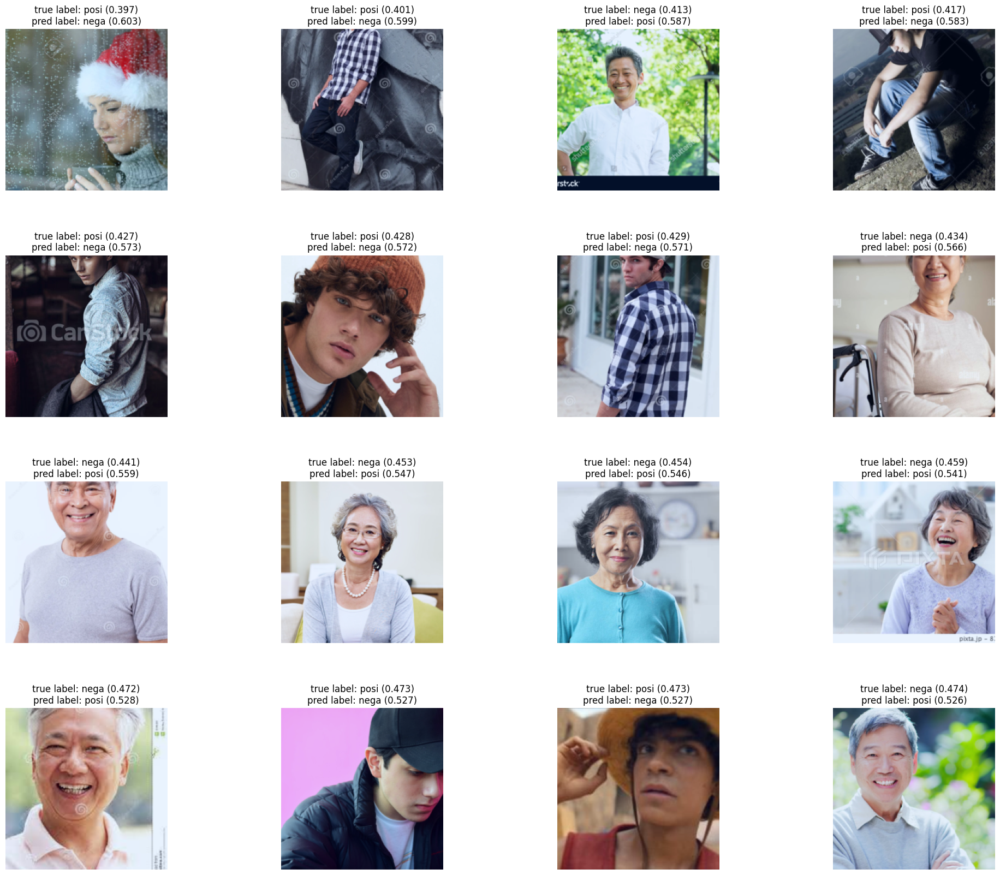

In [140]:
N_IMAGES = len(incorrect_examples)

plot_most_incorrect(incorrect_examples, classes, N_IMAGES)

## disambiguite Target test

#### k doi mu

In [141]:
testa_dir=name_dir+'/featureexploredataset/targettest/k_doi_mu'
BATCH_SIZEa=1
testa_data = datasets.ImageFolder(root = testa_dir,
                                 transform = test_transforms)
testa_iterator = data.DataLoader(testa_data,
                                batch_size = BATCH_SIZEa)

In [142]:
def get_predictions(model, iterator):

    model.eval()

    images = []
    labels = []
    probs = []

    with torch.no_grad():

        for (x, y) in iterator:

            x = x.to(device)

            yhat, _ = model(x)

            y_pred_ensemble= torch.stack(torch.chunk(yhat, SAMPLES, dim=-1)).softmax(dim=-1)
            # y_pred=y_pred_ensemble.mean(dim=0)######################################svgd
            y_pred=(y_pred_ensemble[0]+y_pred_ensemble[2])/2.0######################################svgd


            y_prob = F.softmax(y_pred, dim = -1)
            top_pred = y_prob.argmax(1, keepdim = True)

            images.append(x.cpu())
            labels.append(y.cpu())
            probs.append(y_prob.cpu())

    images = torch.cat(images, dim = 0)
    labels = torch.cat(labels, dim = 0)
    probs = torch.cat(probs, dim = 0)

    return images, labels, probs

In [143]:
images, labels, probs = get_predictions(model, testa_iterator)
pred_labels = torch.argmax(probs, 1)

In [144]:
corrects = torch.eq(labels, pred_labels)
corrects

tensor([ True,  True, False,  True,  True, False,  True, False,  True, False,
        False,  True,  True,  True,  True,  True,  True, False,  True, False,
        False,  True, False,  True, False, False, False, False,  True,  True,
         True, False,  True, False,  True, False, False,  True,  True, False,
        False, False, False, False,  True, False,  True,  True,  True,  True,
        False, False, False,  True, False,  True,  True,  True,  True,  True,
        False, False,  True,  True, False,  True, False, False, False,  True,
        False,  True, False,  True, False, False,  True,  True, False,  True,
         True, False,  True,  True, False, False,  True,  True,  True,  True,
         True,  True, False, False,  True,  True,  True, False,  True,  True,
        False, False,  True,  True,  True,  True,  True,  True,  True,  True,
        False,  True,  True,  True, False,  True,  True,  True,  True,  True,
        False, False,  True,  True, False,  True,  True,  True, 

In [145]:
len(corrects)- torch.sum(corrects)

tensor(57)

In [146]:
corrects.float().mean()

tensor(0.7246)

In [147]:
incorrect_examples = []

for image, label, prob, correct in zip(images, labels, probs, corrects):
    if not correct:########## cmt nếu muốn show all
        incorrect_examples.append((image, label, prob))

incorrect_examples.sort(reverse = True, key = lambda x: torch.max(x[2], dim = 0).values)

In [148]:
incorrect_examples

[(tensor([[[ 1.1700,  1.2043,  1.2043,  ...,  1.2214,  1.2214,  1.2214],
           [ 1.1700,  1.2043,  1.2043,  ...,  1.2214,  1.2214,  1.2214],
           [ 1.1700,  1.2043,  1.2043,  ...,  1.2214,  1.2214,  1.2214],
           ...,
           [ 0.5364,  0.8618,  1.3755,  ...,  0.9303,  0.8618,  0.7933],
           [-0.3369, -0.6794,  0.1768,  ...,  0.8961,  0.8276,  0.7591],
           [-0.5767, -1.1589, -0.7479,  ...,  0.8961,  0.8276,  0.7591]],
  
          [[ 1.5007,  1.5357,  1.5357,  ...,  1.5532,  1.5532,  1.5532],
           [ 1.5007,  1.5357,  1.5357,  ...,  1.5532,  1.5532,  1.5532],
           [ 1.5007,  1.5357,  1.5357,  ...,  1.5532,  1.5532,  1.5532],
           ...,
           [ 0.9580,  1.4482,  2.0259,  ...,  1.3606,  1.3256,  1.2556],
           [ 0.1176, -0.0574,  0.8880,  ...,  1.3256,  1.2906,  1.2206],
           [-0.0749, -0.5126, -0.0399,  ...,  1.3256,  1.2906,  1.2206]],
  
          [[ 1.7511,  1.7860,  1.7860,  ...,  1.8034,  1.8034,  1.8034],
           

In [149]:
count=0
for i in incorrect_examples:
  if(max(i[2].numpy())>=0.6):
    count+=1
print(count)
print(len(incorrect_examples))
count/len(incorrect_examples)

0
57


0.0

In [150]:
def plot_most_incorrect(incorrect, classes, n_images, normalize = True):

    rows = int(np.sqrt(n_images))
    cols = int(np.sqrt(n_images))

    fig = plt.figure(figsize = (25, 20))

    for i in range(rows*cols):

        ax = fig.add_subplot(rows, cols, i+1)

        image, true_label, probs = incorrect[i]
        image = image.permute(1, 2, 0)
        true_prob = probs[true_label]
        incorrect_prob, incorrect_label = torch.max(probs, dim = 0)
        true_class = classes[true_label]
        incorrect_class = classes[incorrect_label]

        if normalize:
            image = normalize_image(image)

        ax.imshow(image.cpu().numpy())
        ax.set_title(f'true label: {true_class} ({true_prob:.3f})\n' \
                     f'pred label: {incorrect_class} ({incorrect_prob:.3f})')
        ax.axis('off')

    fig.subplots_adjust(hspace=0.4)

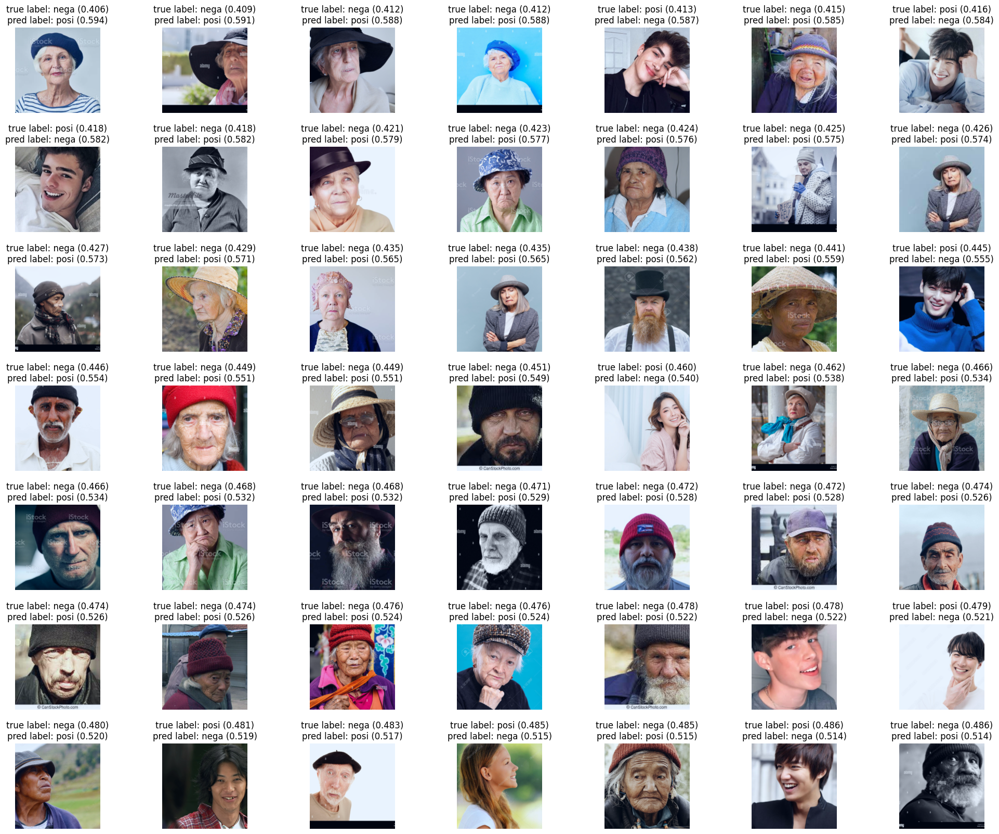

In [151]:
N_IMAGES = len(incorrect_examples)

plot_most_incorrect(incorrect_examples, classes, N_IMAGES)

#### k_tre

In [152]:
testa_dir=name_dir+'/featureexploredataset/targettest/k_tre'
BATCH_SIZEa=1
testa_data = datasets.ImageFolder(root = testa_dir,
                                 transform = test_transforms)
testa_iterator = data.DataLoader(testa_data,
                                batch_size = BATCH_SIZEa)

In [153]:
def get_predictions(model, iterator):

    model.eval()

    images = []
    labels = []
    probs = []

    with torch.no_grad():

        for (x, y) in iterator:

            x = x.to(device)

            yhat, _ = model(x)

            y_pred_ensemble= torch.stack(torch.chunk(yhat, SAMPLES, dim=-1)).softmax(dim=-1)
            # y_pred=y_pred_ensemble.mean(dim=0)######################################svgd
            y_pred=(y_pred_ensemble[1]+y_pred_ensemble[2])/2.0######################################svgd


            y_prob = F.softmax(y_pred, dim = -1)
            top_pred = y_prob.argmax(1, keepdim = True)

            images.append(x.cpu())
            labels.append(y.cpu())
            probs.append(y_prob.cpu())

    images = torch.cat(images, dim = 0)
    labels = torch.cat(labels, dim = 0)
    probs = torch.cat(probs, dim = 0)

    return images, labels, probs

In [154]:
images, labels, probs = get_predictions(model, testa_iterator)
pred_labels = torch.argmax(probs, 1)

In [155]:
corrects = torch.eq(labels, pred_labels)
corrects

tensor([False, False,  True, False, False, False, False, False,  True,  True,
         True, False, False,  True,  True, False, False,  True,  True,  True,
        False, False,  True,  True,  True,  True, False,  True, False, False,
         True,  True, False,  True, False,  True, False, False,  True, False,
         True,  True, False, False, False, False, False, False,  True, False,
         True,  True, False,  True, False, False, False,  True,  True, False,
        False,  True, False,  True,  True,  True, False,  True, False, False,
        False,  True,  True, False,  True,  True, False, False, False, False,
         True,  True,  True, False, False,  True,  True,  True, False,  True,
        False, False, False,  True,  True,  True,  True, False, False,  True,
         True, False, False,  True,  True,  True,  True, False,  True,  True,
         True,  True,  True, False,  True,  True, False,  True,  True,  True,
         True,  True,  True,  True,  True,  True,  True,  True, 

In [156]:
len(corrects)- torch.sum(corrects)

tensor(73)

In [157]:
corrects.float().mean()


tensor(0.6605)

In [158]:
incorrect_examples = []

for image, label, prob, correct in zip(images, labels, probs, corrects):
    if not correct:
        incorrect_examples.append((image, label, prob))

incorrect_examples.sort(reverse = True, key = lambda x: torch.max(x[2], dim = 0).values)

In [159]:
incorrect_examples

[(tensor([[[ 0.5193,  0.4337,  0.3823,  ...,  0.8618,  0.8104,  0.7933],
           [ 0.6906,  0.6221,  0.5536,  ...,  0.9132,  0.8789,  0.8789],
           [ 0.8104,  0.7419,  0.7077,  ...,  0.8961,  0.8961,  0.8961],
           ...,
           [-0.1999, -0.1486, -0.0972,  ...,  0.8104,  0.7933,  0.7933],
           [-0.2684, -0.2684, -0.2684,  ...,  0.8276,  0.8276,  0.8276],
           [-0.3541, -0.3712, -0.3712,  ...,  0.8276,  0.8276,  0.8276]],
  
          [[ 0.3277,  0.2402,  0.1877,  ...,  0.5728,  0.5203,  0.5028],
           [ 0.4678,  0.3978,  0.3277,  ...,  0.6078,  0.5728,  0.5728],
           [ 0.5903,  0.5203,  0.4853,  ...,  0.5903,  0.5903,  0.5903],
           ...,
           [-1.2304, -1.1779, -1.1429,  ...,  0.6604,  0.6429,  0.6429],
           [-1.2654, -1.2654, -1.2654,  ...,  0.6604,  0.6604,  0.6604],
           [-1.3529, -1.3529, -1.3529,  ...,  0.6604,  0.6604,  0.6604]],
  
          [[ 0.0779, -0.0092, -0.1138,  ...,  0.1825,  0.1476,  0.1302],
           

In [160]:
count=0
for i in incorrect_examples:
  if(max(i[2].numpy())>=0.6):
    count+=1
print(count)
print(len(incorrect_examples))
count/len(incorrect_examples)

2
73


0.0273972602739726

In [161]:
def plot_most_incorrect(incorrect, classes, n_images, normalize = True):

    rows = int(np.sqrt(n_images))
    cols = int(np.sqrt(n_images))

    fig = plt.figure(figsize = (25, 20))

    for i in range(rows*cols):

        ax = fig.add_subplot(rows, cols, i+1)

        image, true_label, probs = incorrect[i]
        image = image.permute(1, 2, 0)
        true_prob = probs[true_label]
        incorrect_prob, incorrect_label = torch.max(probs, dim = 0)
        true_class = classes[true_label]
        incorrect_class = classes[incorrect_label]

        if normalize:
            image = normalize_image(image)

        ax.imshow(image.cpu().numpy())
        ax.set_title(f'true label: {true_class} ({true_prob:.3f})\n' \
                     f'pred label: {incorrect_class} ({incorrect_prob:.3f})')
        ax.axis('off')

    fig.subplots_adjust(hspace=0.4)

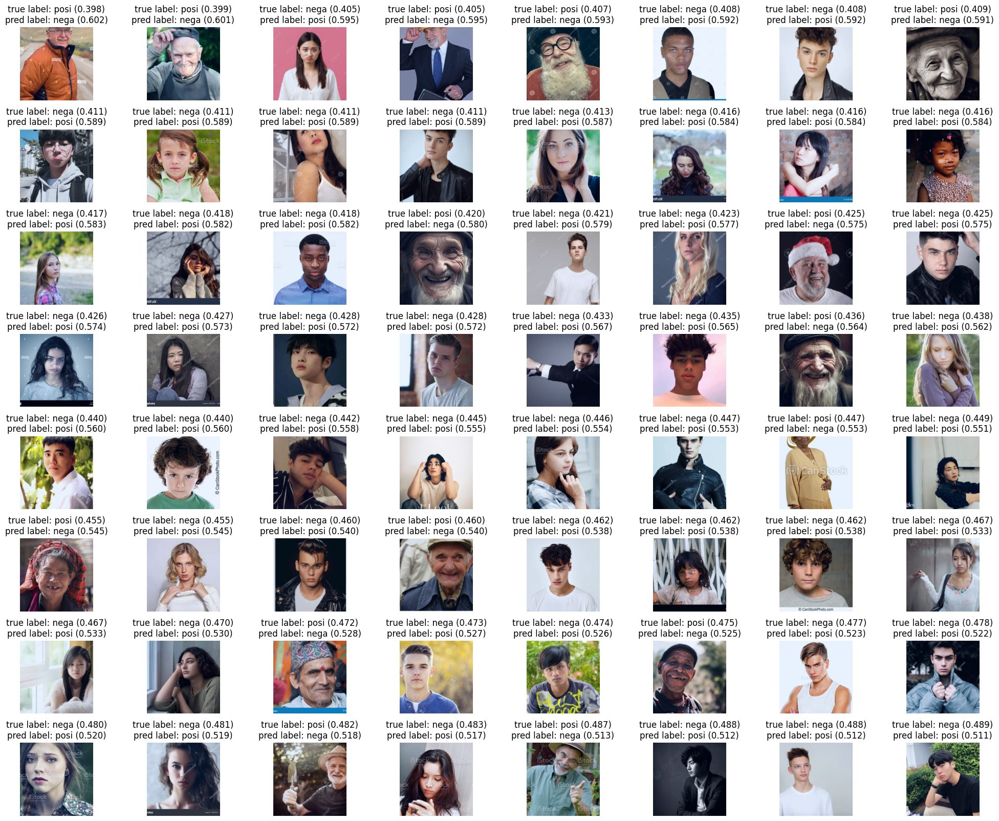

In [162]:
N_IMAGES = len(incorrect_examples)####(labels)

plot_most_incorrect(incorrect_examples, classes, N_IMAGES)

#### k cuoi

In [163]:
testa_dir=name_dir+'/featureexploredataset/targettest/kcuoi'
# testa_dir='/content/drive/MyDrive/ambidata/featureexploredataset/testtrain'
BATCH_SIZEa=1
testa_data = datasets.ImageFolder(root = testa_dir,
                                 transform = test_transforms)
testa_iterator = data.DataLoader(testa_data,
                                batch_size = BATCH_SIZEa)

In [164]:
def get_predictions(model, iterator):

    model.eval()

    images = []
    labels = []
    probs = []

    with torch.no_grad():

        for (x, y) in iterator:

            x = x.to(device)

            yhat, _ = model(x)

            y_pred_ensemble= torch.stack(torch.chunk(yhat, SAMPLES, dim=-1)).softmax(dim=-1)
            # y_pred=y_pred_ensemble.mean(dim=0)######################################svgd
            y_pred=(y_pred_ensemble[1]+y_pred_ensemble[2])/2.0######################################svgd


            y_prob = F.softmax(y_pred, dim = -1)
            top_pred = y_prob.argmax(1, keepdim = True)

            images.append(x.cpu())
            labels.append(y.cpu())
            probs.append(y_prob.cpu())

    images = torch.cat(images, dim = 0)
    labels = torch.cat(labels, dim = 0)
    probs = torch.cat(probs, dim = 0)

    return images, labels, probs

In [165]:
images, labels, probs = get_predictions(model, testa_iterator)
pred_labels = torch.argmax(probs, 1)

In [166]:
corrects = torch.eq(labels, pred_labels)
corrects

tensor([ True, False,  True,  True,  True,  True,  True,  True,  True,  True,
         True, False,  True,  True,  True, False,  True,  True,  True,  True,
         True, False,  True,  True,  True,  True,  True,  True,  True,  True,
         True,  True,  True,  True,  True, False,  True,  True,  True,  True,
         True,  True,  True,  True,  True,  True,  True,  True, False,  True,
         True,  True, False,  True,  True,  True,  True,  True,  True,  True,
         True,  True,  True,  True,  True, False,  True,  True,  True,  True,
         True, False,  True,  True,  True,  True,  True,  True,  True,  True,
        False,  True,  True,  True,  True,  True, False,  True, False,  True,
         True,  True,  True,  True,  True,  True,  True,  True, False,  True,
         True,  True,  True,  True,  True,  True,  True,  True, False,  True,
         True,  True,  True,  True,  True,  True,  True,  True,  True,  True,
         True,  True, False,  True,  True,  True,  True,  True, 

In [167]:
len(corrects)- torch.sum(corrects)

tensor(22)

In [168]:
corrects.float().mean()

tensor(0.8883)

In [169]:
incorrect_examples = []

for image, label, prob, correct in zip(images, labels, probs, corrects):
    if not correct:########## cmt nếu muốn show all
        incorrect_examples.append((image, label, prob))

incorrect_examples.sort(reverse = True, key = lambda x: torch.max(x[2], dim = 0).values)

In [170]:
incorrect_examples

[(tensor([[[0.4679, 0.6563, 0.4508,  ..., 0.2453, 0.1597, 0.1939],
           [0.4337, 0.4851, 0.4508,  ..., 0.1597, 0.1597, 0.2282],
           [0.6734, 0.6049, 0.5536,  ..., 0.2453, 0.1939, 0.2796],
           ...,
           [0.5536, 0.4851, 0.4508,  ..., 0.6734, 0.6221, 0.7248],
           [0.5536, 0.4851, 0.4166,  ..., 0.7762, 0.7762, 0.7933],
           [0.5536, 0.4851, 0.3994,  ..., 0.9303, 0.9817, 0.9132]],
  
          [[0.7304, 0.9230, 0.6779,  ..., 0.3277, 0.2402, 0.2577],
           [0.7129, 0.7654, 0.7479,  ..., 0.2577, 0.2402, 0.3102],
           [0.9755, 0.9055, 0.8704,  ..., 0.3277, 0.2752, 0.3452],
           ...,
           [0.7829, 0.7479, 0.6604,  ..., 1.0805, 1.0105, 1.1155],
           [0.7829, 0.7479, 0.6604,  ..., 1.1681, 1.1681, 1.1856],
           [0.8179, 0.7654, 0.6604,  ..., 1.3606, 1.4132, 1.3431]],
  
          [[0.6182, 0.8797, 0.4614,  ..., 0.2696, 0.1825, 0.2696],
           [0.5485, 0.7054, 0.5834,  ..., 0.1999, 0.1825, 0.3045],
           [0.7576, 0.

In [171]:
count=0
for i in incorrect_examples:
  if(max(i[2].numpy())>=0.6):
    count+=1
print(count)
print(len(incorrect_examples))
count/len(incorrect_examples)

1
22


0.045454545454545456

In [172]:
def plot_most_incorrect(incorrect, classes, n_images, normalize = True):

    rows = int(np.sqrt(n_images))
    cols = int(np.sqrt(n_images))

    fig = plt.figure(figsize = (25, 20))

    for i in range(rows*cols):

        ax = fig.add_subplot(rows, cols, i+1)

        image, true_label, probs = incorrect[i]
        image = image.permute(1, 2, 0)
        true_prob = probs[true_label]
        incorrect_prob, incorrect_label = torch.max(probs, dim = 0)
        true_class = classes[true_label]
        incorrect_class = classes[incorrect_label]

        if normalize:
            image = normalize_image(image)

        ax.imshow(image.cpu().numpy())
        ax.set_title(f'true label: {true_class} ({true_prob:.3f})\n' \
                     f'pred label: {incorrect_class} ({incorrect_prob:.3f})')
        ax.axis('off')

    fig.subplots_adjust(hspace=0.4)

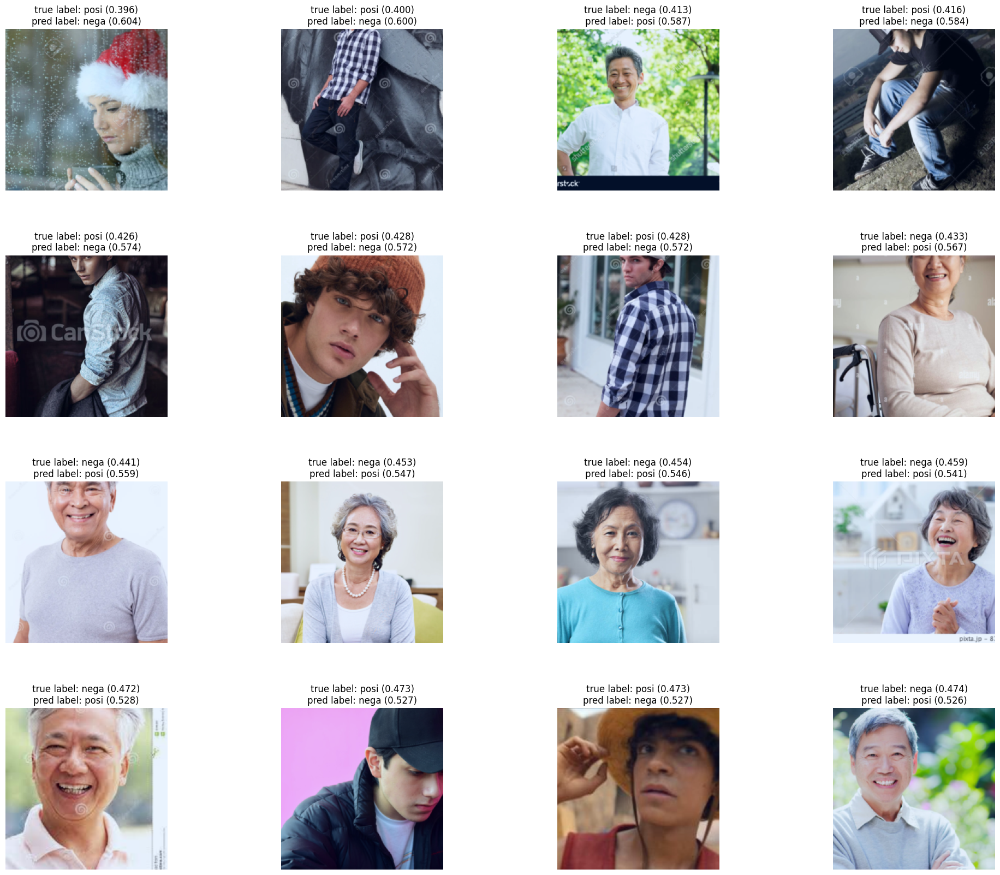

In [173]:
N_IMAGES = len(incorrect_examples)

plot_most_incorrect(incorrect_examples, classes, N_IMAGES)